In [1]:
import numpy as np
import os
import pandas as pd
from matplotlib import pyplot as plt

In [2]:
path = "./receptive_field_experiments"
if not os.path.exists(path):
    os.mkdir(path)

In [3]:
from matplotlib import rc

params = {
#           'text.latex.preamble': [r'\usepackage{gensymb}'],
          'axes.labelsize': 24,#18, # fontsize for x and y labels (was 10)
          'axes.titlesize': 24,#18,
          'font.size': 26, # was 16
          'legend.fontsize': 20, # was 10
          'xtick.labelsize': 14,
          'ytick.labelsize': 14,
          'font.family': 'serif',
          'figure.dpi': 300
}
#mpl.rcParams['figure.dpi'] = 900
import matplotlib
matplotlib.rcParams.update(params)
#rc('text', usetex=True)

In [4]:
{   
    "ResNet18": {
    'train-conv1': 7 
    'train-layer1-0-conv1': 19,
    'train-layer1-0-conv2': 27,
    'train-layer1-1-conv1': 19,
    'train-layer1-1-conv2': 27,
    'train-layer2-0-downsample-0': 11,
    'train-layer2-0-conv1': 19,
    'train-layer2-0-conv2': 35,
    'train-layer2-1-conv1': 27,
    'train-layer2-1-conv2': 43,
    'train-layer3-0-downsample-0': 11 ,
    'train-layer3-0-conv1': 27,
    'train-layer3-0-conv2': 61,
    'train-layer3-1-conv1': 43,
    'train-layer3-1-conv2': 77,
    'train-layer4-0-downsample-0': 11,
    'train-layer4-0-conv1': 43,
    'train-layer4-0-conv2': 107,
    'train-layer4-1-conv1': 75,
    'train-layer4-1-conv2': 139,
    'train-fc': 0
},
    "ResNet34": {
    'train-conv1': 7,
    'train-layer1-0-conv1': 19,
    'train-layer1-0-conv2': 27,
    'train-layer1-1-conv1': 19,
    'train-layer1-1-conv2': 27,
    'train-layer1-2-conv1': 19, 
    'train-layer1-2-conv2': 27,
    'train-layer2-0-downsample-0': 11,
    'train-layer2-0-conv1': 19,
    'train-layer2-0-conv2': 35, 
    'train-layer2-1-conv1': 27,
    'train-layer2-1-conv2': 43,
    'train-layer2-2-conv1': 27,
    'train-layer2-2-conv2': 43,
    'train-layer2-3-conv1': 27,
    'train-layer2-3-conv2': 43,
    'train-layer3-0-downsample-0': 11,
    'train-layer3-0-conv1': 27,
    'train-layer3-0-conv2': 61,
    'train-layer3-1-conv1': 43,
    'train-layer3-1-conv2': 77,
    'train-layer3-2-conv1': 43,
    'train-layer3-2-conv2': 77,
    'train-layer3-3-conv1': 43,
    'train-layer3-3-conv2': 77,
    'train-layer3-4-conv1': 43,
    'train-layer3-4-conv2': 77,
    'train-layer3-5-conv1': 43,
    'train-layer3-5-conv2': 77,
    'train-layer4-0-downsample-0': 11,
    'train-layer4-0-conv1': 43 ,
    'train-layer4-0-conv2': 107,
    'train-layer4-1-conv1': 75,
    'train-layer4-1-conv2': 139,
    'train-layer4-2-conv1': 75 ,
    'train-layer4-2-conv2': 139,
    'train-fc': 512, 
}
}

SyntaxError: invalid syntax (<ipython-input-4-157a617270cb>, line 4)

In [5]:
receptive_fields = {
    'VGG13': './receptive_field/VGG13.csv',
    'VGG13_D2': './receptive_field/VGG13_D2.csv',
    'VGG13_D4': './receptive_field/VGG13_D4.csv',
}

resolutions = {
    'Cifar10': 32,
    'Cifar10_132': 132,
    'Cifar10_140': 140,
    'Cifar10_150': 150,
    'Cifar10_75': 75,
    'Cifar10_38': 38,
    'Cifar10_300': 300,
    'Cifar10_600': 600,
}

In [6]:
from typing import Tuple

def extract_layer_stat(df, epoch=19, primary_metric=None, stat='saturation') -> Tuple[pd.DataFrame, float]:
    """
    Extracts a specific statistic for a single epoch from a result dataframe as produced by the CSV-writer
    :param df: The dataframe produced by a CSVWriter
    :param epoch: Epoch to filter by
    :param primary_metric: Primary metric for performance evaluation (optional)
    :param stat: The statistic to match. Must be a substring matching all columns belonging to stat statistic like "saturation"
    :return: A dataframe with a single row, corresponding to the epoch containing only the columns that contain the substring
    described in the stat-parameter in their name. Second return value is the primary metric value
    """
    cols = list(df.columns)
    train_cols = [col for col in cols if
                  'train' in col and not 'accuracy' in col and stat in col and not 'classifier' in col and not 'downsample' in col and not "shortcut" in col and not 'fc' in col and not "linear" in col]
    #print(train_cols)
    
    if not np.any(epoch == df.index.values):
        raise ValueError(f'Epoch {epoch} could not be recoreded, dataframe has only the following indices: {df.index.values}')
    epoch_df = df[df.index.values == len(df)-1]
    pm = None if primary_metric is None else epoch_df[primary_metric].values[0]
    epoch_df = epoch_df[train_cols]
    return epoch_df, pm

def find_border_layer(receptive_fields_in_layer, input_res):
    #print(receptive_fields_in_layer)
    k = receptive_fields_in_layer > input_res
    x = np.argmax(k)
    #print(k)
    return len(k)-1 if all(k == False) else x + 1

def plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res: int = 32):
    template = f"./logs/{model}/{dataset}_{input_res}/{run_id}"
    receptive_field = f"{template}/" + f"receptive_field_{model}_{dataset}_{input_res}.csv"
    file: str = f'{template}/{model}-{dataset}-r{input_res}-bs{batch_size}-e{epochs}.csv'
    rf = pd.read_csv(receptive_field, sep=';', index_col=0)
    mdl = pd.read_csv(file, sep=';', index_col=0)
    df, pm = extract_layer_stat(mdl, epoch=29, primary_metric='test_accuracy', stat='saturation')
    res = "2x2" if "TinyImageNet" in dataset else "4x4"
    probe_accs = pd.read_csv(f'{template}/{res}_probe_performances.csv', sep=';', index_col=0)
    probe_accs.head()

    feature_maps = rf['map_size'].values

    fig, ax1 = plt.subplots(figsize=(10, 2.5))

    receptive_field_evolution = rf['receptive_field'].values
    indices = list(range(len(receptive_field_evolution)))
    
    # ResNer18
    #receptive_field_evolution = [7, 19, 27, 19, 27, 19, 35, 27, 43, 27, 61, 43, 77, 43, 107, 75, 139]
    # ResNet34
    #receptive_field_evolution = [7, 
    #                             19, 27, 
    #                             19, 27, 
    #                             19, 27, 
    #                             
    #                             19, 35, 
    #                             27, 43, 
    #                             27, 43, 
    #                             27, 43, 
    #                             
    #                             27, 61, 
    #                             43, 77, 
    #                             43, 77, 
    #                             43, 77, 
    #                             43, 77,
    #                             43, 77,
    #                             
    #                             43, 107,
    #                             75, 139,
    #                             75, 139]
    ax1.plot(indices, receptive_field_evolution, label='Receptive Field Size', color='blue')
    ax1.scatter(indices, receptive_field_evolution, color='blue')
    
   # ax1.plot(indices, feature_maps, label='Feature Map Size', color='blue')
   # ax1.scatter(indices, feature_maps, color='blue')
    
    ax2 = ax1.twinx() 
    
    print(len(df.columns), len(indices), len(probe_accs))
    if "Squeeze" in model:
        ax2.plot(indices[:-1], df.values[0,:], label='Saturation', color="green")
        ax2.scatter(indices[:-1], df.values[0,:], color="green")
    else:
        ax2.plot(indices[:], df.values[0,:], label='Saturation', color="green")
        ax2.scatter(indices[:], df.values[0,:], color="green")
    if 'VGG' in model:
        filtered_probes = cleaned_probe_accs(probe_accs)['eval_acc'][:-2]
        ax2.plot(indices, filtered_probes, label='Probe Accuracy', color="red")
        ax2.scatter(indices, filtered_probes, color="red")
    elif "MSNet" in model or "DenseNet" in model:
        filtered_probes = cleaned_probe_accs(probe_accs)['eval_acc'][:-1]
        ax2.plot(indices, filtered_probes, label='Probe Accuracy', color="red")
        ax2.scatter(indices, filtered_probes, color="red")
    elif "Squeeze" in model:
        ax2.plot(indices, probe_accs['eval_acc'].values[:], label='Probe Accuracy', color="red")
        ax2.scatter(indices, probe_accs['eval_acc'].values[:], color="red")
    elif 'ResNet' in model:
        filtered_probes = cleaned_probe_accs(probe_accs)['eval_acc']
        ax2.plot(indices, filtered_probes, label='Probe Accuracy', color="red")
        ax2.scatter(indices, filtered_probes, color="red")
    if pm is not None:
        model_baseline = [pm / 100 for _ in range(len(indices))]
        ax2.plot(indices, model_baseline, color='black', linestyle='--', label=f'model test acc.: {round(pm, 2)}%')
    ax2.set_ylabel("Sat. / Probe Acc.")
    #ax1.set_ylabel("Receptive Field Size")
    ax1.set_ylabel("Rec. Field Size")
    #ax1.yaxis.set_label_position("top")
    #ax2.yaxis.set_label_position("right")
    ax2.vlines(find_border_layer(receptive_field_evolution, input_res), 0, 1)

    #ax2.vlines(1 + (2*3) + (2*4) + 1, 0, 1)
    #ax2.vlines(1 + (2*2) + (2*2) + 1, 0, 1)

    plt.grid()
    fig.legend(bbox_to_anchor=(.925, 1.45), framealpha=0.2, ncol=2)
    
    ax1.set_xticks([])
    ax1.set_xlabel("Layers")

    #plt.title(f"Test Accuracy: {round(1*pm, 2)}%")

def cleaned_probe_accs(probe_accs):
    return probe_accs[probe_accs['name'].apply(lambda name: not 'fc' in name and not 'downsample' in name and not "linear" in name and not "shortcut" in name)]

8 8 10
VGG11
10 10 12
VGG13
13 13 15
VGG16
16 16 18
VGG19


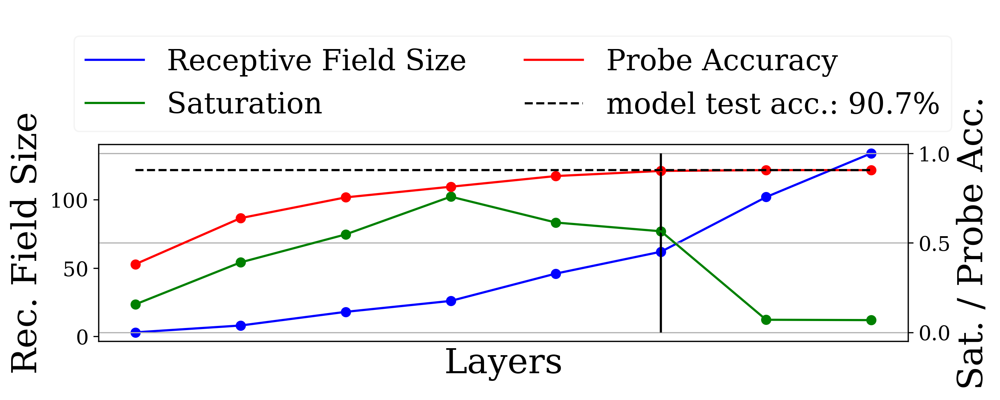

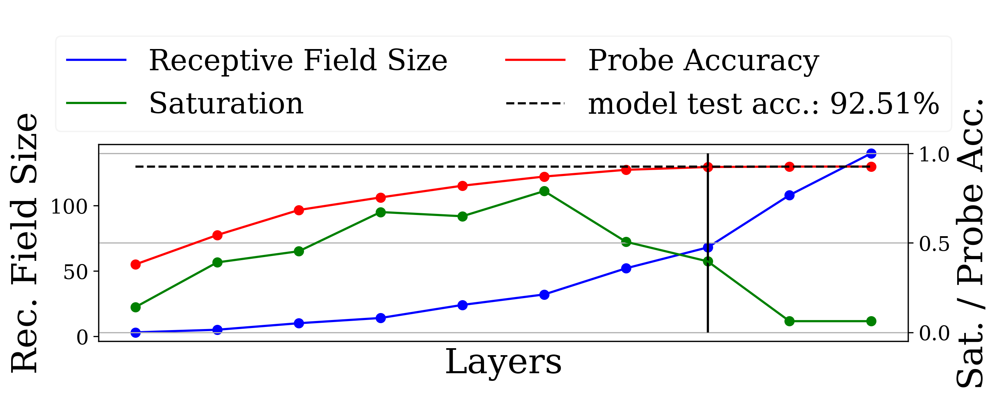

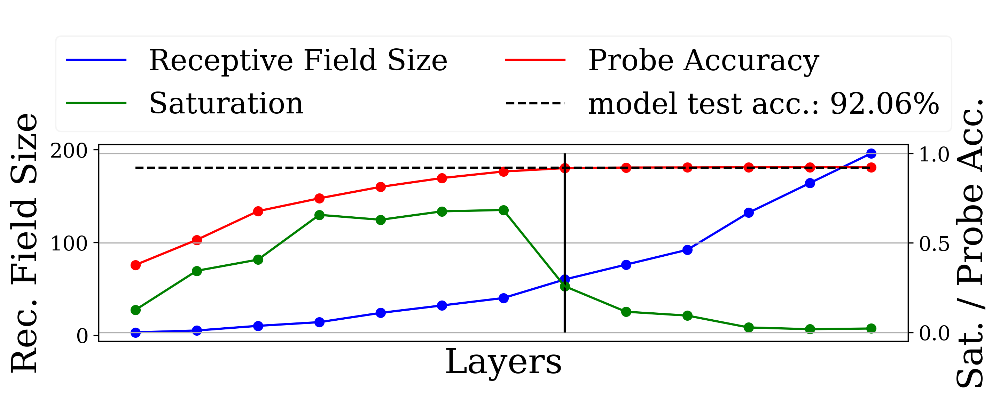

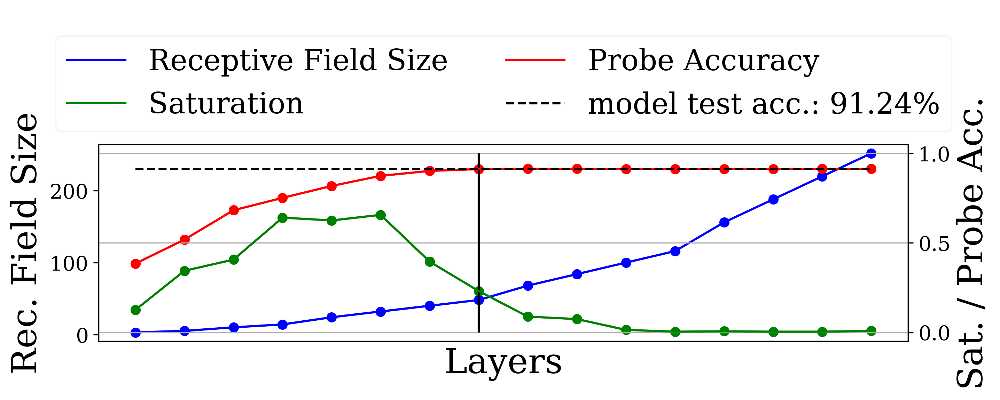

In [7]:
for model in ['VGG11', 'VGG13', 'VGG16', 'VGG19']:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.pdf')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

17 17 18
ResNet18NoSkip


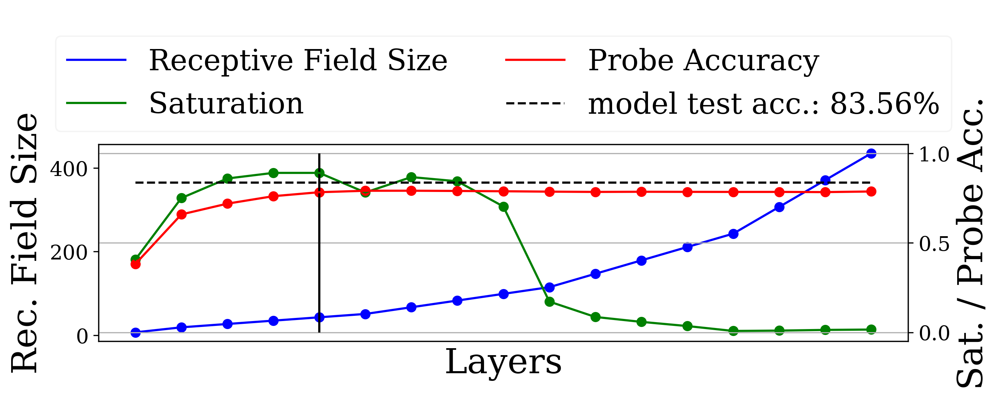

In [8]:
for model in ['ResNet18NoSkip']:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 128
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.pdf')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

16 16 18
VGG19_D3


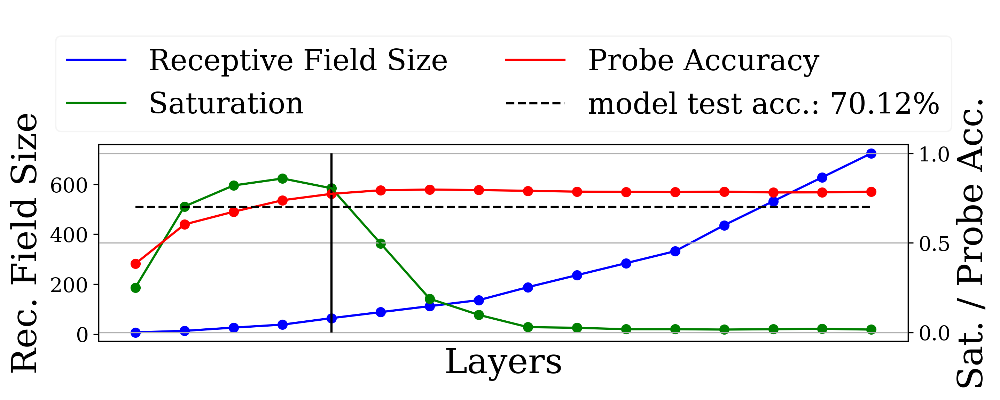

In [9]:
for model in ["VGG19_D3"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 200
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'B2P'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.pdf')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

In [10]:
x =  './logs/VGG19_D3/Cifar10_32/DIS/receptive_field_VGG19_D3_Cifar10_32.csv'
from pathlib import Path
Path(x).parent.

SyntaxError: invalid syntax (<ipython-input-10-9ef7f4618807>, line 3)

In [11]:
for model in ['VGG11_XXXS', 'VGG13_XXXS', 'VGG16_XXXS', 'VGG19_XXXS']:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

FileNotFoundError: [Errno 2] No such file or directory: './logs/VGG11_XXXS/Cifar10_32/DIS/receptive_field_VGG11_XXXS_Cifar10_32.csv'

In [12]:
for model in ['VGG11_XXS', 'VGG13_XXS', 'VGG16_XXS', 'VGG19_XXS']:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

FileNotFoundError: [Errno 2] No such file or directory: './logs/VGG11_XXS/Cifar10_32/DIS/receptive_field_VGG11_XXS_Cifar10_32.csv'

17 17 21
ResNet18


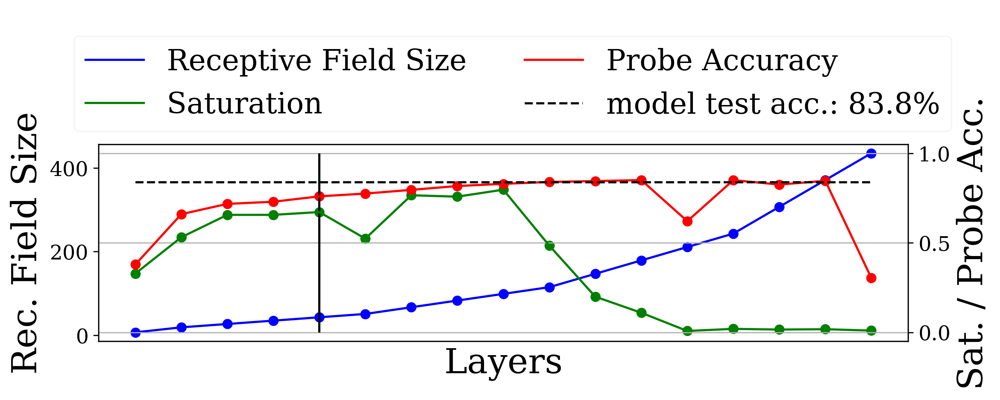

In [13]:
for model in ['ResNet18']:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 30 if not "O7" in model else 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

33 33 37
ResNet34


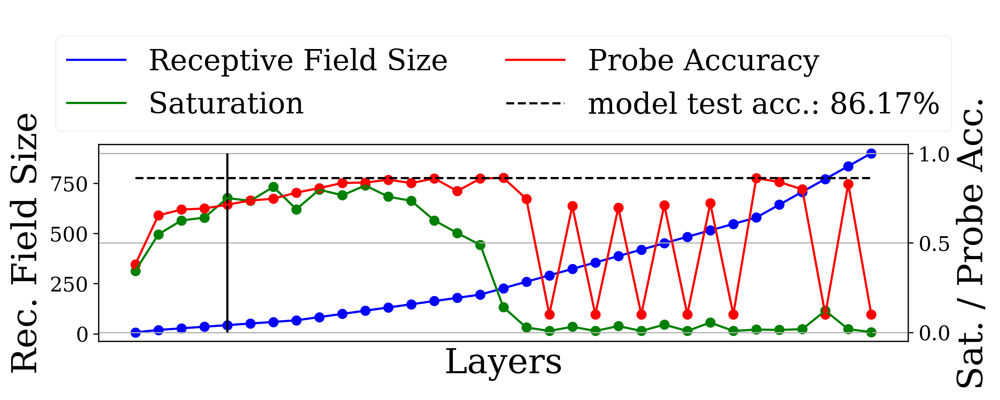

In [14]:
for model in ['ResNet34']:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

17 17 21
ResNet18
17 17 26
ResNet18_O1
17 17 26
ResNet18_O3
17 17 26
ResNet18_O5
17 17 26
ResNet18_O7


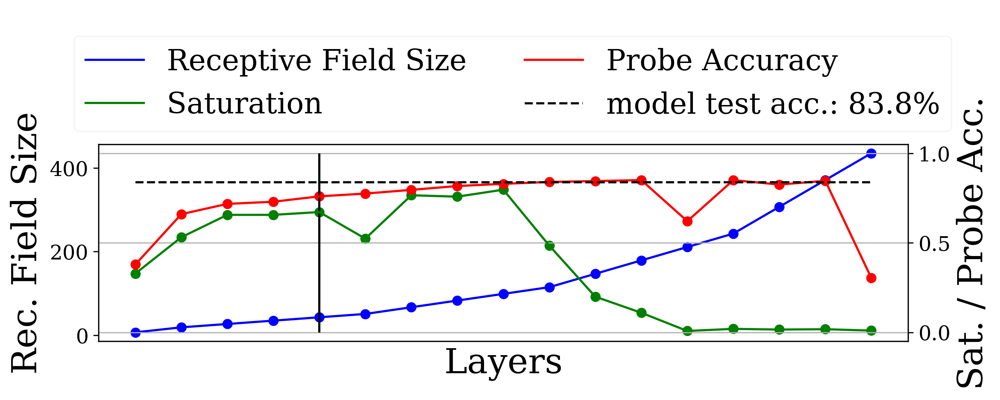

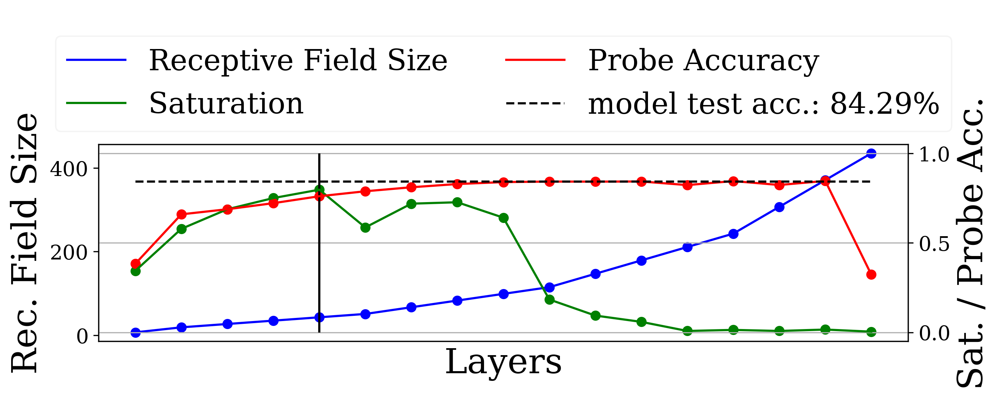

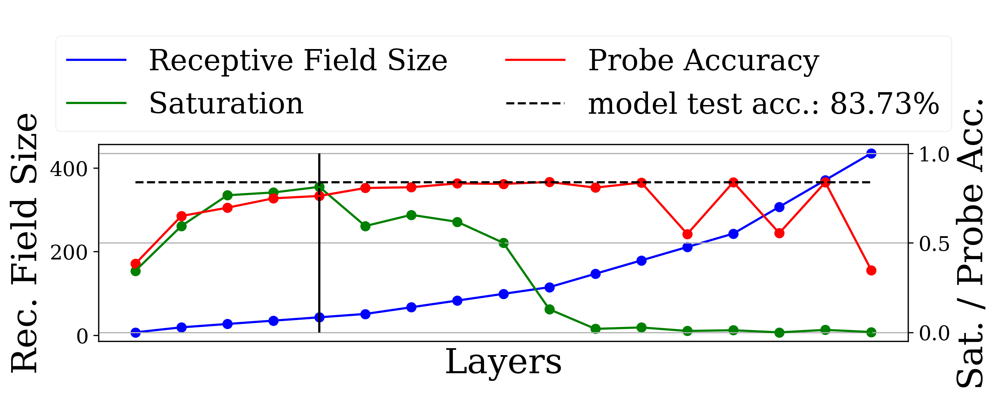

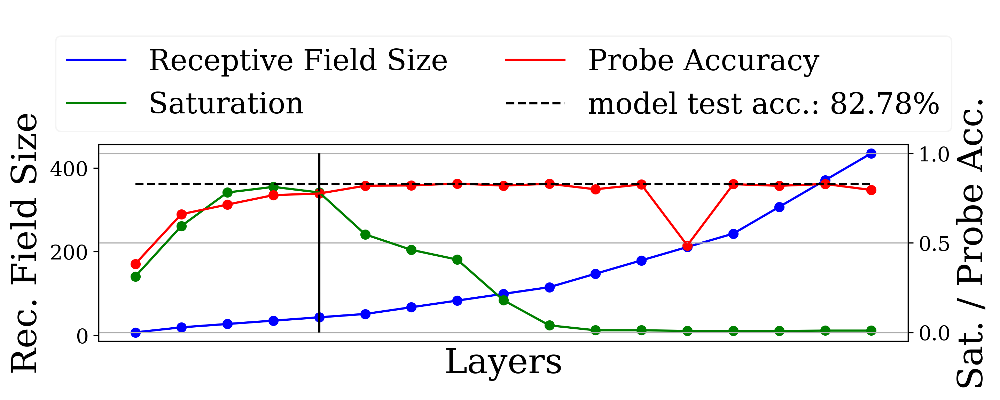

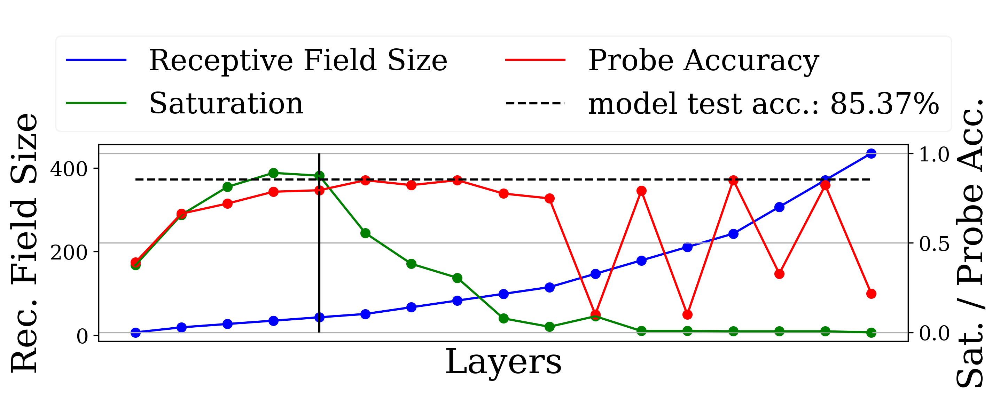

In [15]:
for model in ['ResNet18', "ResNet18_O1", "ResNet18_O3", "ResNet18_O5", "ResNet18_O7"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 30 if not "O7" in model else 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

23 23 24
MSNet22
23 23 24
MSNet22_Swish
23 23 24
MSNet22FPN


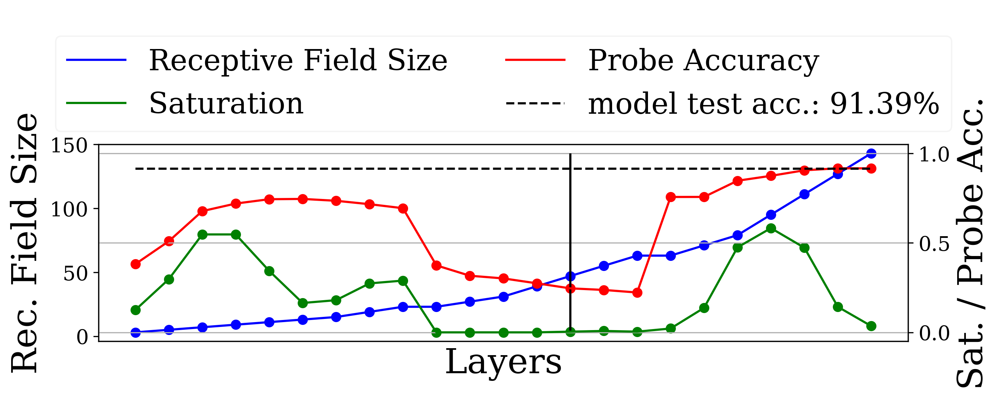

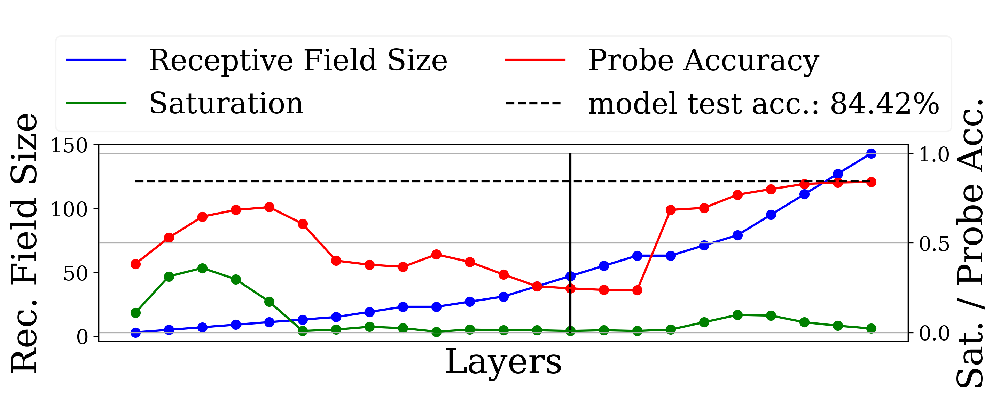

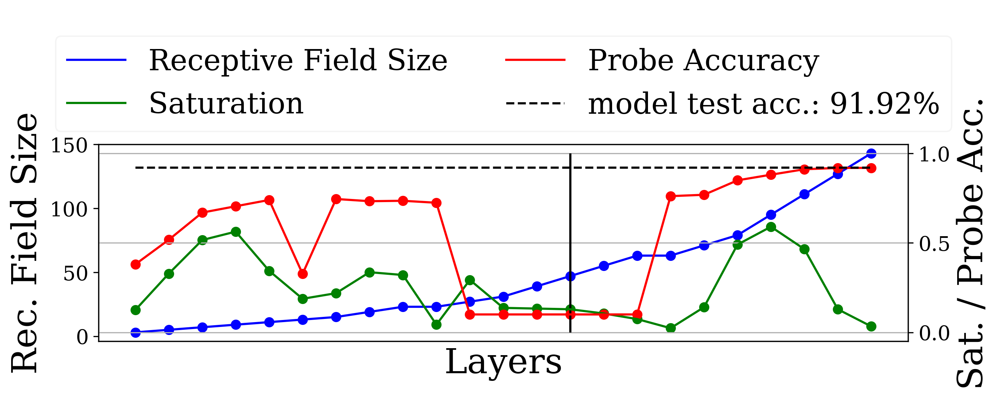

In [16]:
for model in ["MSNet22", "MSNet22_Swish", "MSNet22FPN"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

36 36 37
DenseNet18
68 68 69
DenseNet65


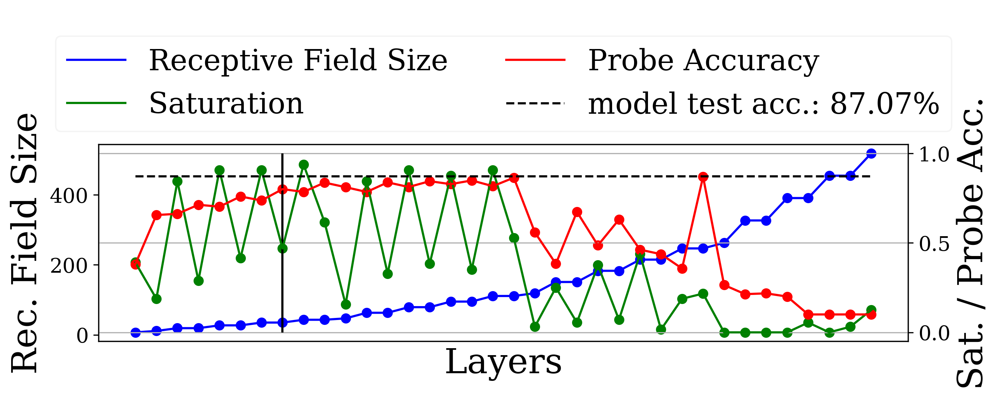

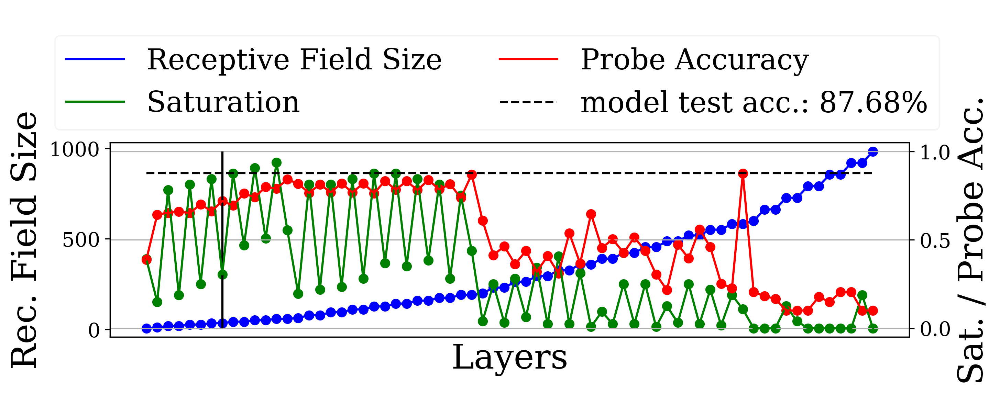

In [17]:
for model in ["DenseNet18", "DenseNet65"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

19 19 20
MSNet18_NS
17 17 18
MSNet18_NSNT


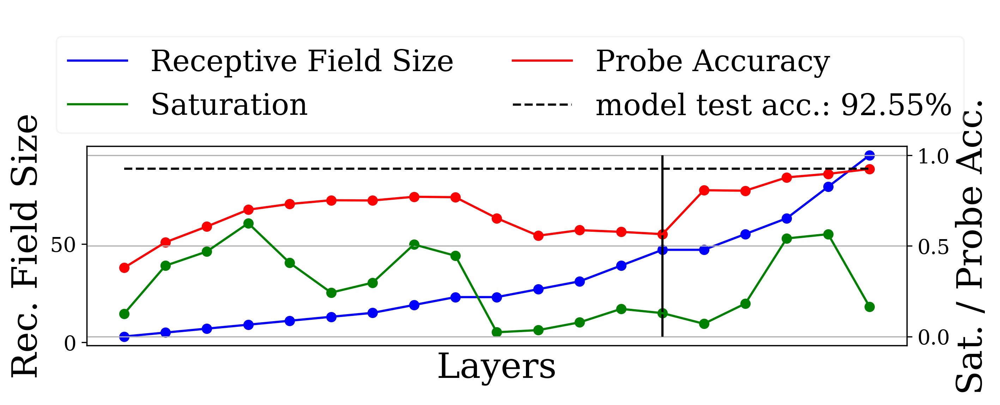

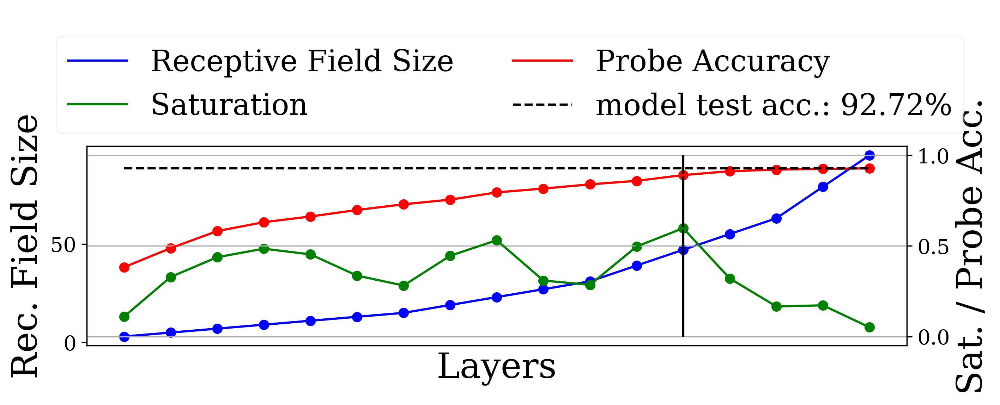

In [120]:
for model in ["MSNet18_NS", "MSNet18_NSNT"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

In [121]:
for model in ["MSNet18", "MSNet_NT"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

FileNotFoundError: [Errno 2] No such file or directory: './logs/MSNet18/Cifar10_32/DIS/receptive_field_MSNet18_Cifar10_32.csv'

16 16 18
VGG19_GX
16 16 50
VGG19_SE


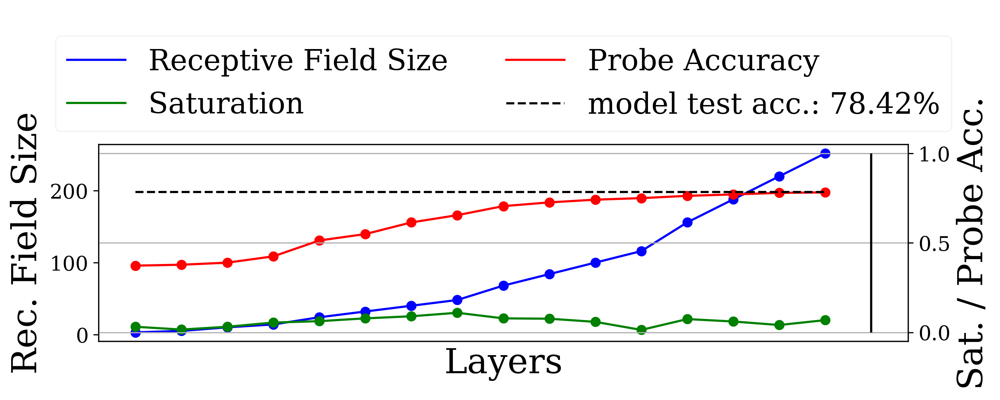

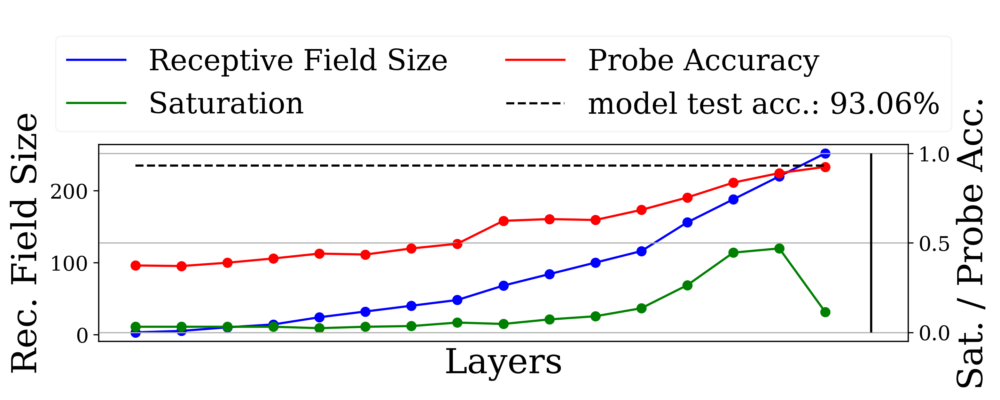

In [122]:
for model in ["VGG19_GX", "VGG19_SE"]:
    dataset = 'Cifar10'
    input_res = 224
    batch_size = 64
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

16 16 18
VGG19_GX
16 16 50
VGG19_SE


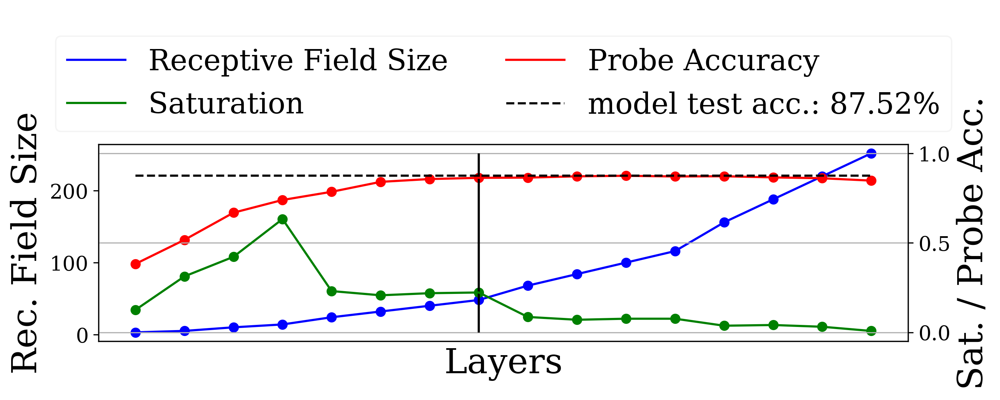

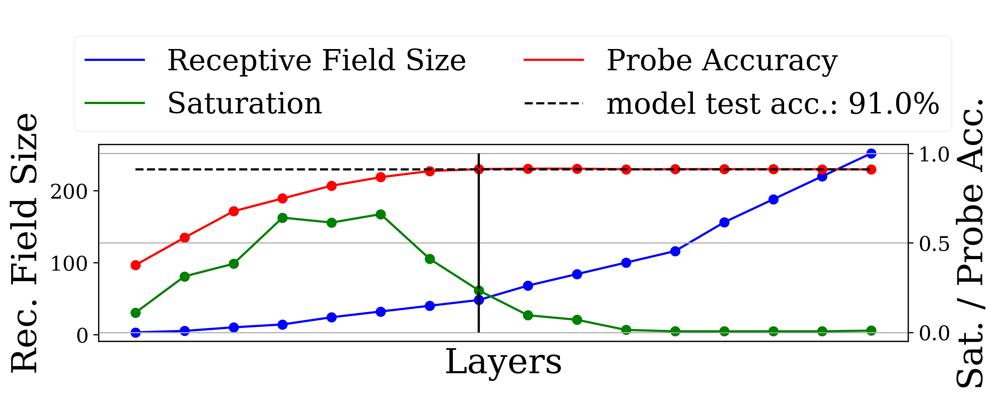

In [123]:
for model in ["VGG19_GX", "VGG19_SE"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

25 25 45
iSEResNet18
25 25 45
iSEResNet18_DW


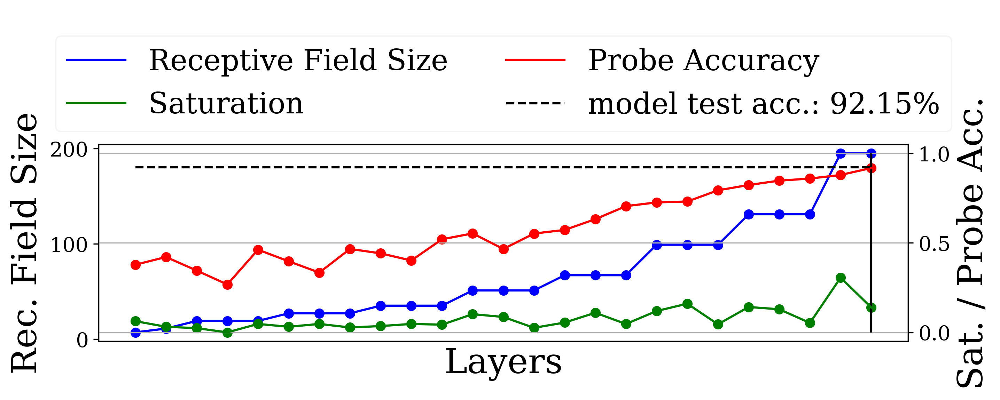

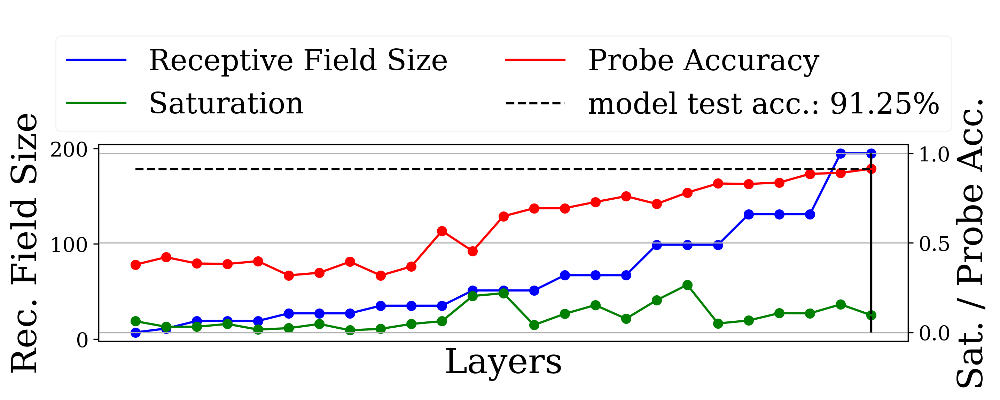

In [124]:
for model in ["iSEResNet18", "iSEResNet18_DW"]:
    dataset = 'Cifar10'
    input_res = 224
    batch_size = 32
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

25 25 45
iSEResNet18
25 25 45
iSEResNet18_DW


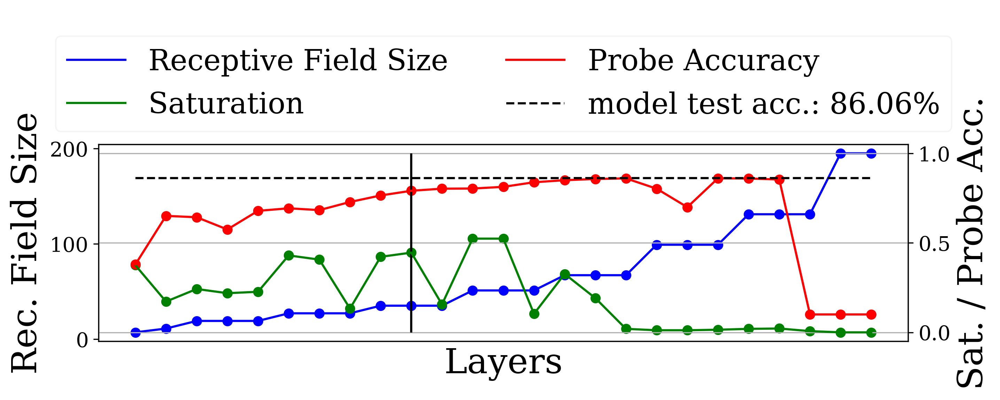

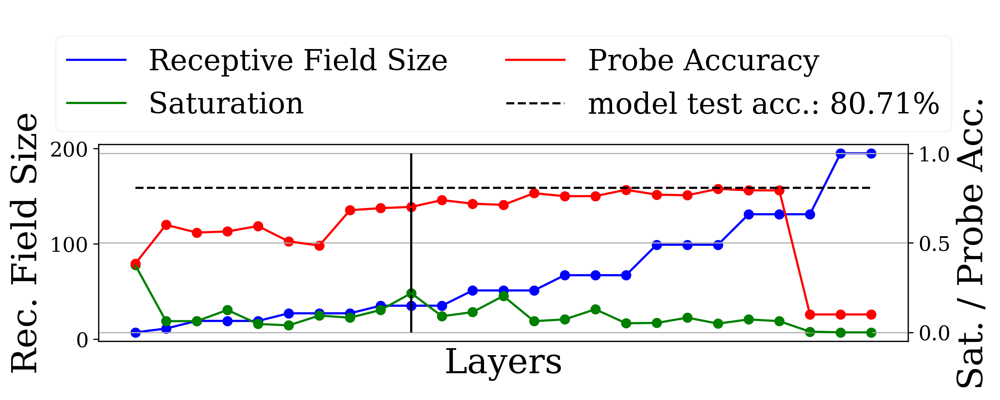

In [125]:
for model in ["iSEResNet18", "iSEResNet18_DW"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 32
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

25 25 29
iResNet18
25 25 29
iResNet18_DW


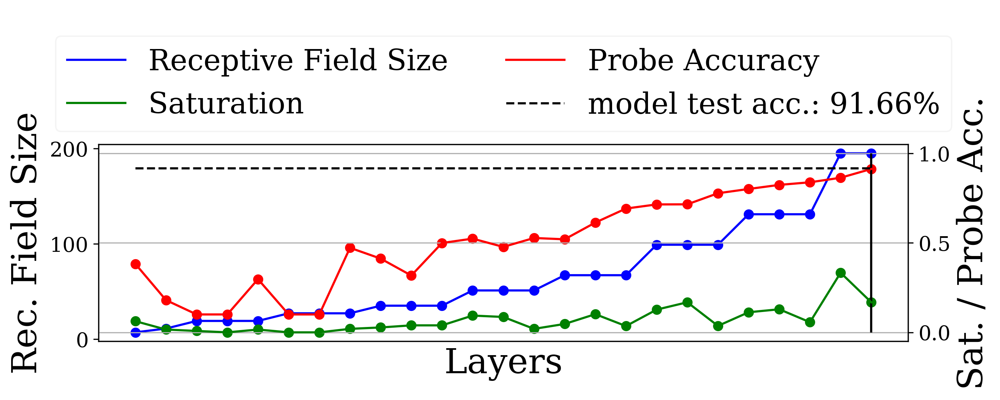

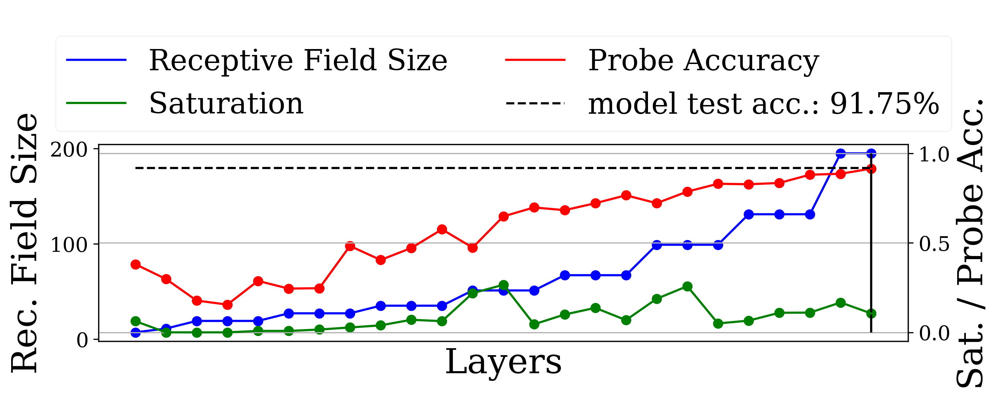

In [126]:
for model in ["iResNet18", "iResNet18_DW"]:
    dataset = 'Cifar10'
    input_res = 224
    batch_size = 32
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

In [127]:
for model in ["iResNet18", "iResNet18_DW"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 32
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

ValueError: Epoch 29 could not be recoreded, dataframe has only the following indices: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16]

In [128]:
for model in ["iResNet18", "iSEResNet18"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 32
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

ValueError: Epoch 29 could not be recoreded, dataframe has only the following indices: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16]

25 25 29
iResNet18_DW
25 25 45
iSEResNet18_DW


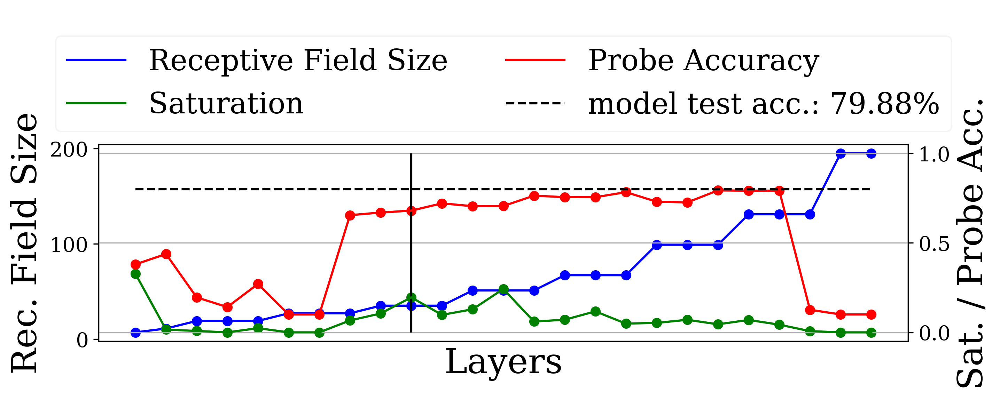

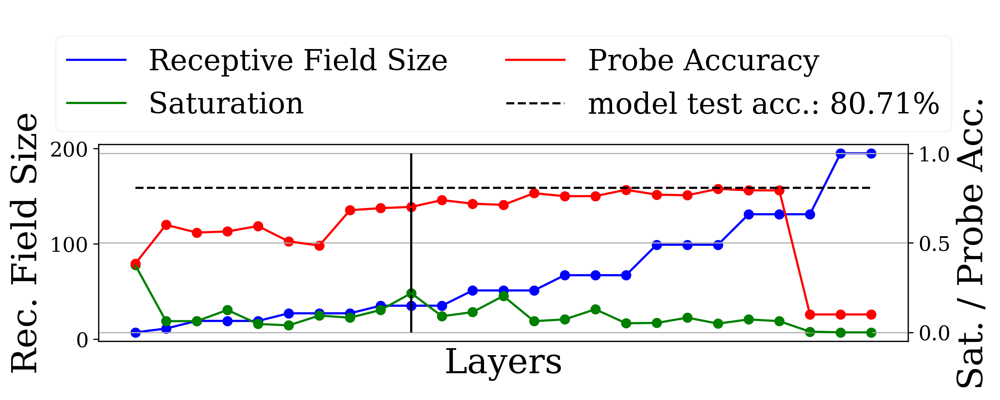

In [129]:
for model in ["iResNet18_DW", "iSEResNet18_DW"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 32
    epochs = 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

16 16 18
VGG19_G2
16 16 18
VGG19_G3


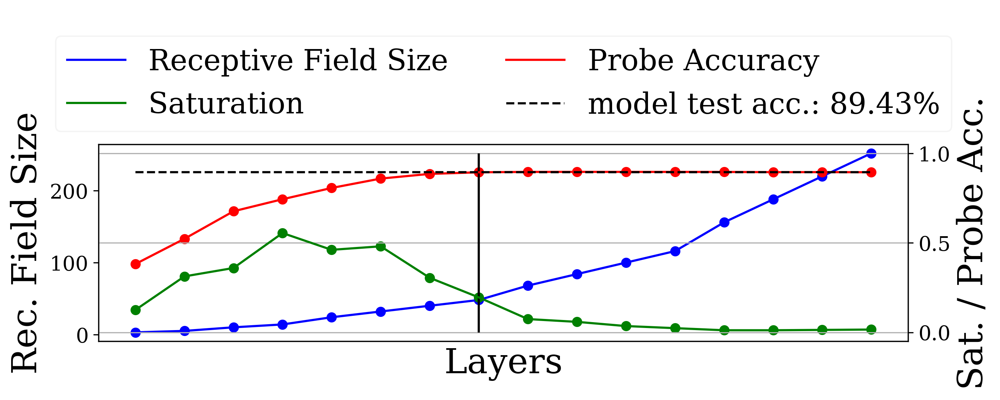

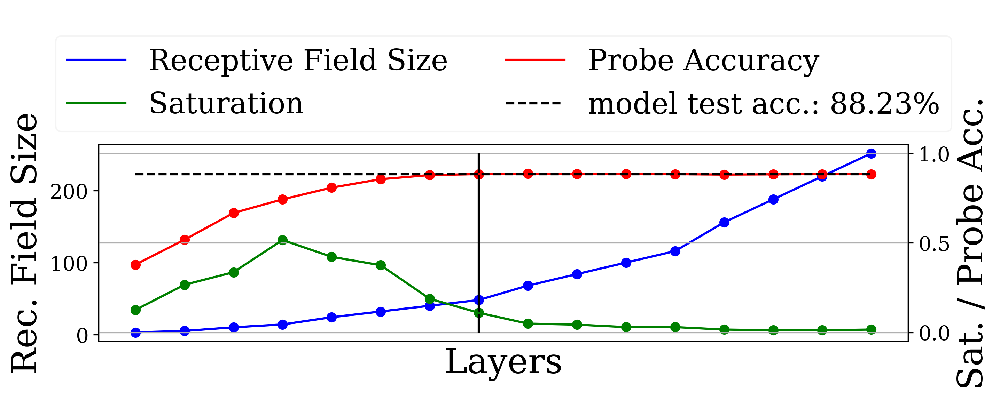

In [130]:
for model in ["VGG19_G2", "VGG19_G3"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'DIS'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    print(model)
    plt.savefig(savepath, bbox_inches='tight')

8 8 10
10 10 12
13 13 15
16 16 18


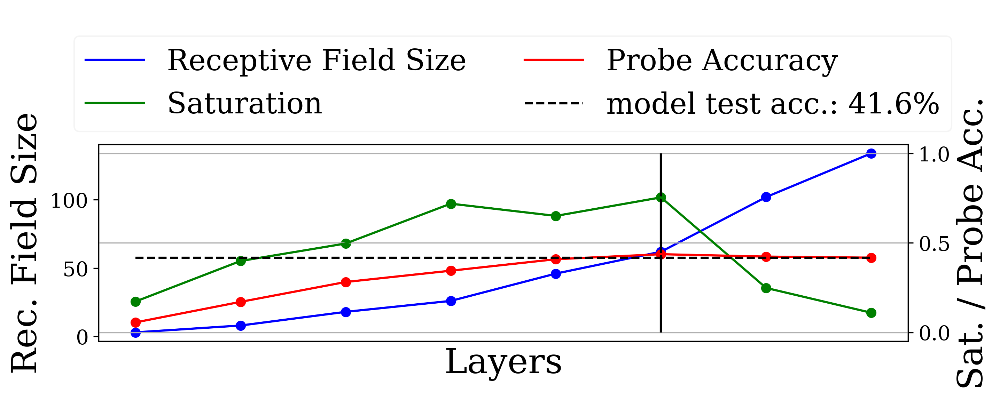

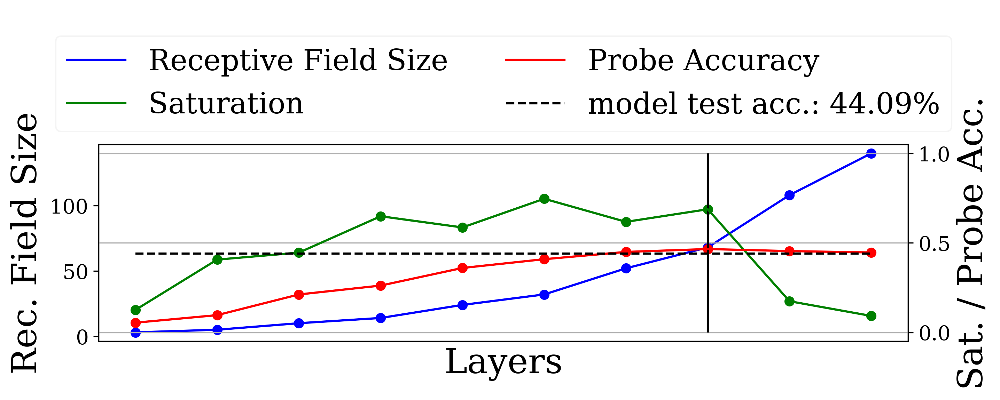

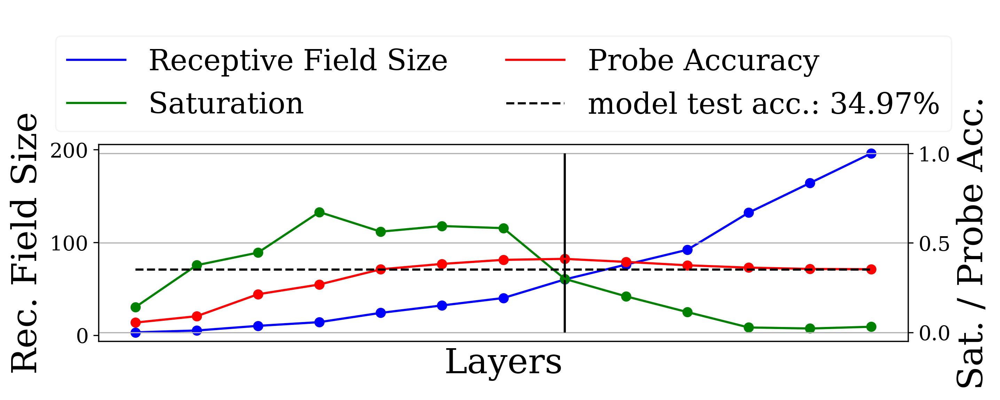

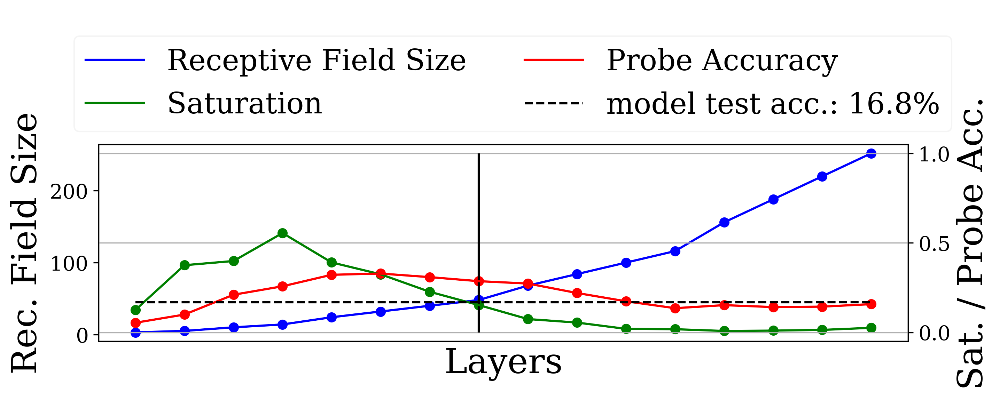

In [13]:
for model in ['VGG11', "VGG13", "VGG16", "VGG19"]:
    dataset = 'TinyImageNet'
    input_res = 32
    batch_size = 64
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'RES'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.pdf')
    plt.savefig(savepath, bbox_inches='tight')

###### for model in ['ResNet18_PC', "ResNet34_PC", "ResNet50_PC"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'RES'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    plt.savefig(savepath, bbox_inches='tight')


17 17 21
17 17 18
33 33 37
49 49 54
49 49 50


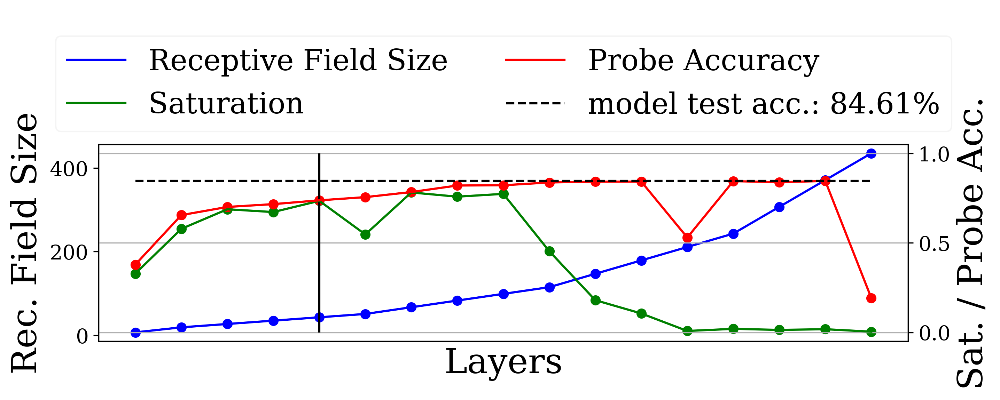

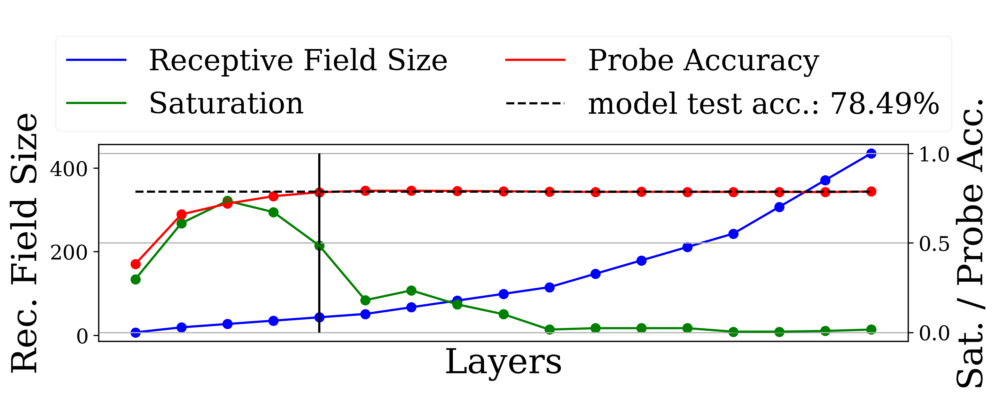

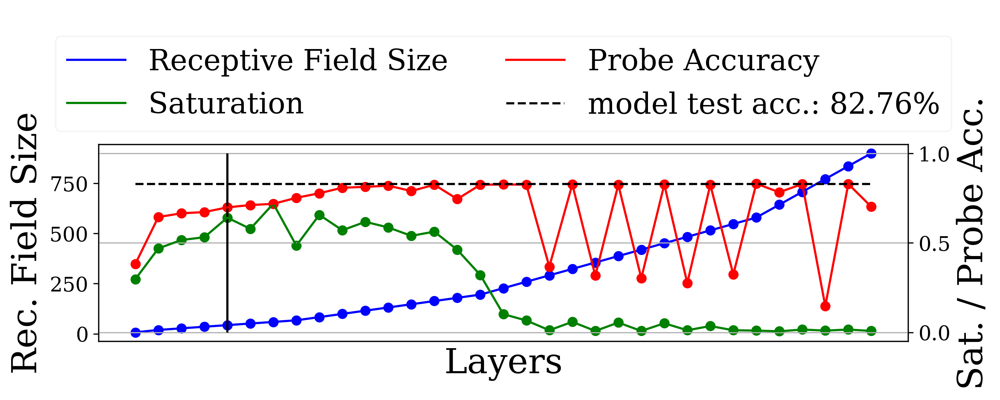

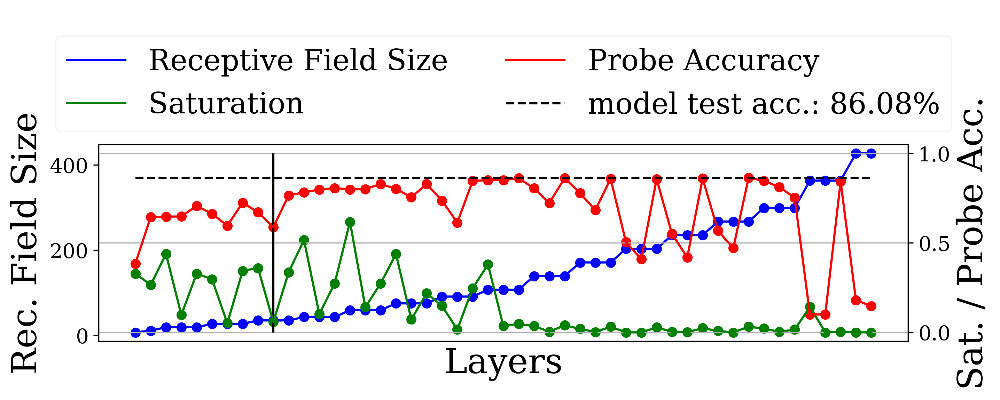

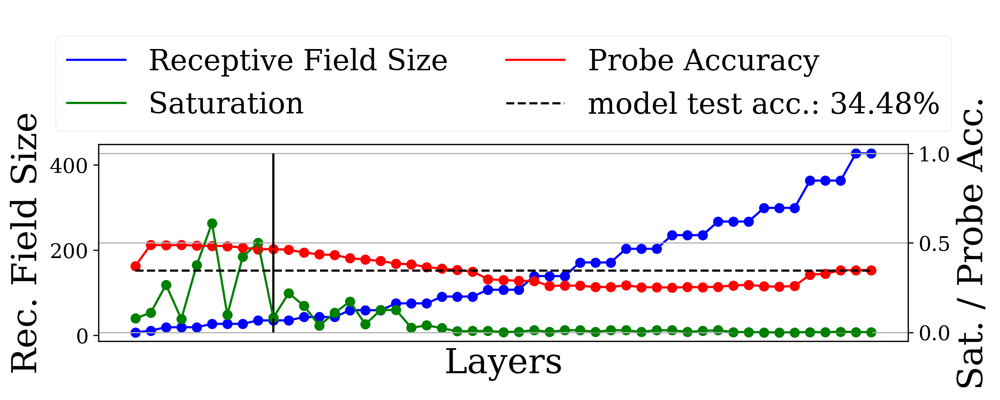

In [133]:
for model in ['ResNet18', "ResNet18NoSkip", "ResNet34", "ResNet50", "ResNet50NoSkip"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64 if model != "ResNet50NoSkip" else 128
    epochs = 30 if model != "ResNet50" else 60
    downsampling = 'None'
    thresh = 10000
    run_id = 'RES'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    plt.savefig(savepath, bbox_inches='tight')

13 13 15


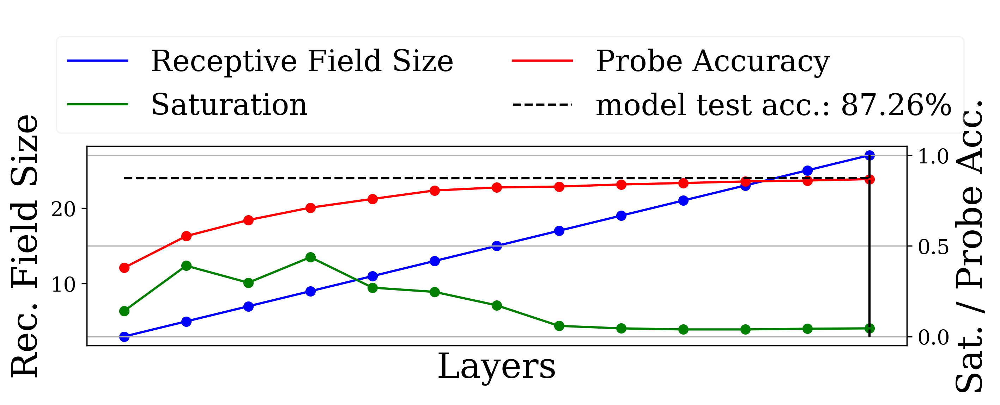

In [134]:
model = 'AlteredPooling5_VGG16'
dataset = 'Cifar10'
input_res = 32
batch_size = 64
epochs = 30
downsampling = 'None'
thresh = 10000
run_id = 'RES'

plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)

17 17 19


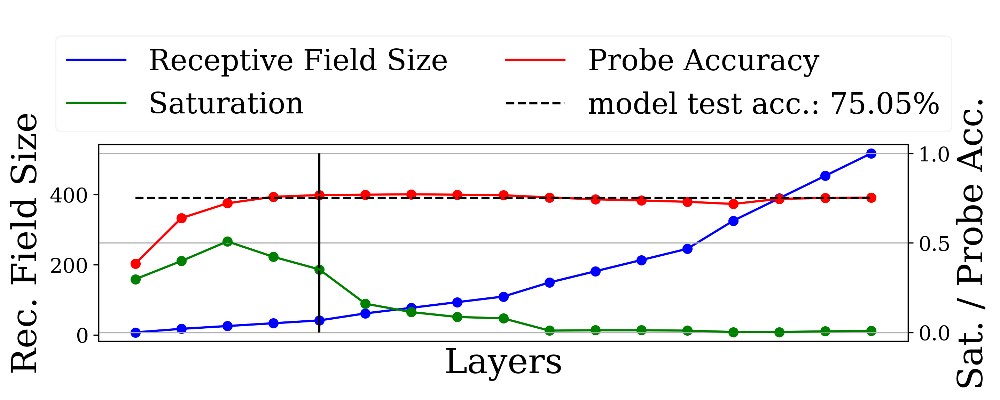

In [135]:
model = 'VGGResNet2'
dataset = 'Cifar10'
input_res = 32
batch_size = 64
epochs = 30
downsampling = 'None'
thresh = 10000
run_id = 'RES'

plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)

17 17 19


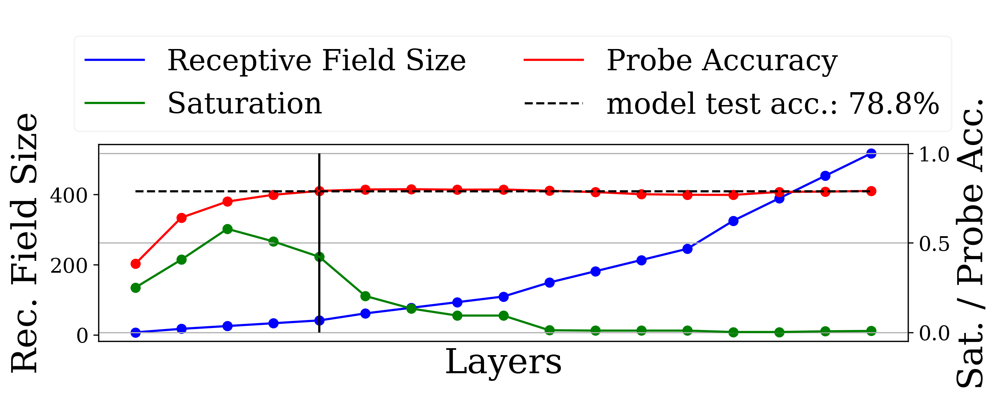

In [136]:
model = 'VGGResNet'
dataset = 'Cifar10'
input_res = 32
batch_size = 64
epochs = 30
downsampling = 'None'
thresh = 10000
run_id = 'RES'

plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)

8 8 10


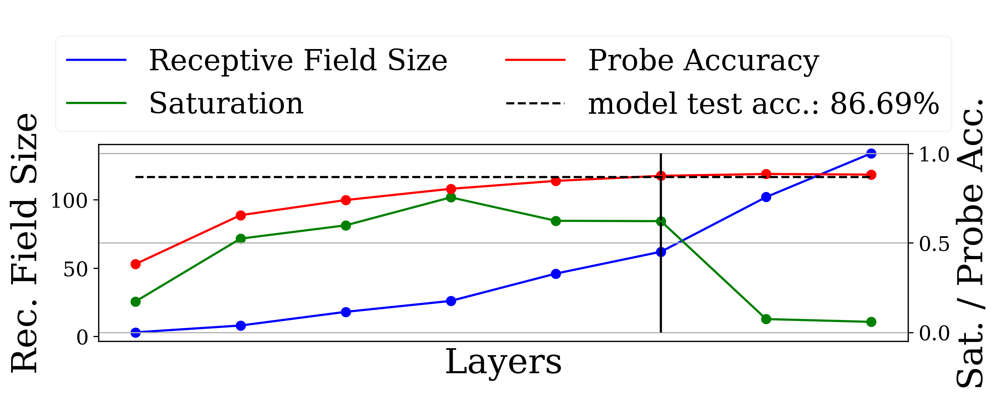

In [137]:
model = 'VGG11'
dataset = 'Cifar10'
input_res = 32
batch_size = 512
epochs = 30
downsampling = 'None'
thresh = 10000
run_id = 'B2P'

plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)

8 8 10
10 10 12
13 13 15
16 16 18


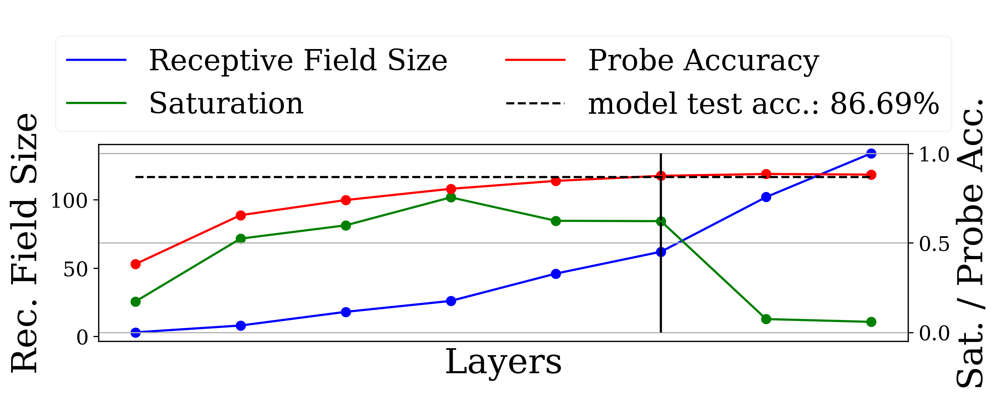

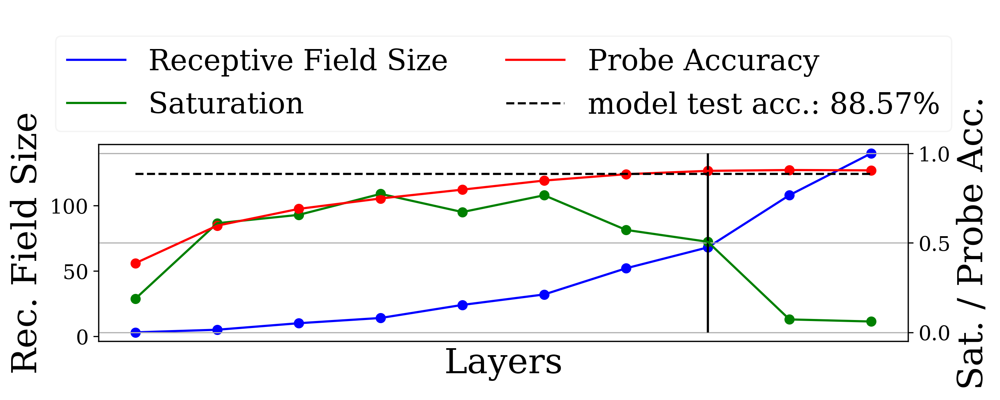

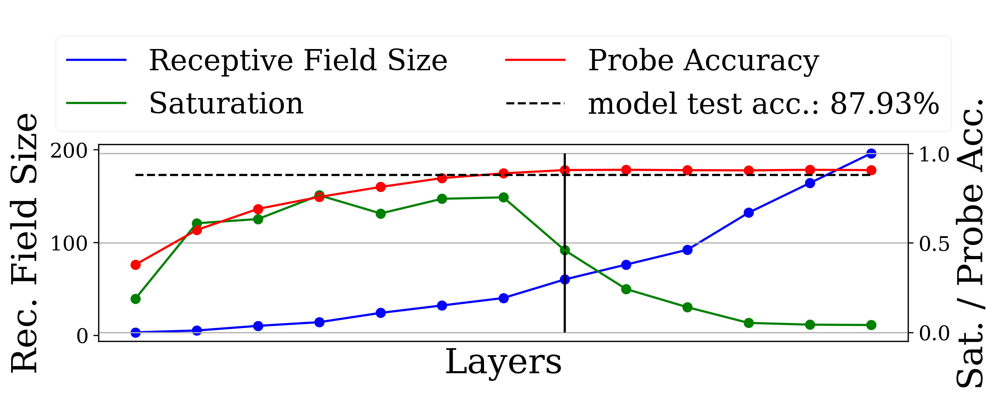

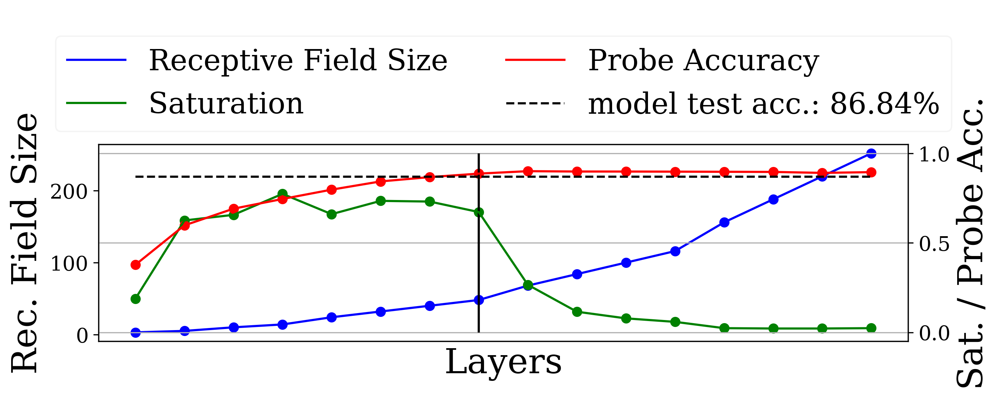

In [138]:
for model in ['VGG11', 'VGG13', 'VGG16', 'VGG19']:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 512
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'B2P'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    plt.savefig(savepath, bbox_inches='tight')

8 8 10
10 10 12
13 13 15
16 16 18


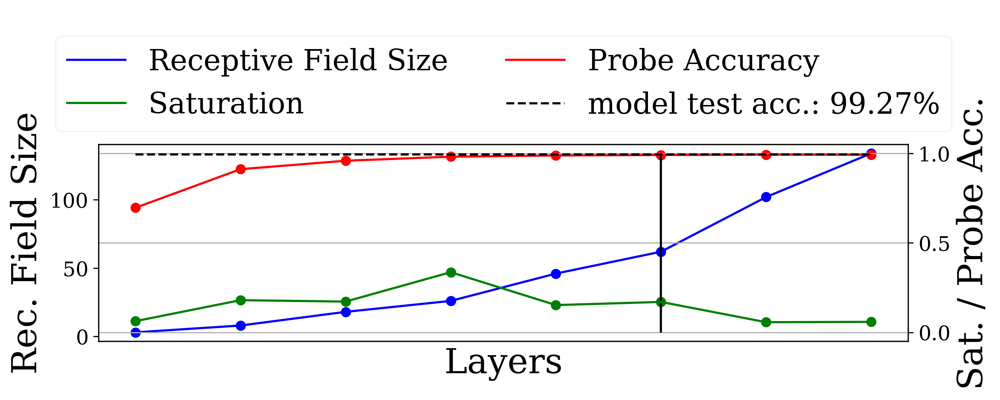

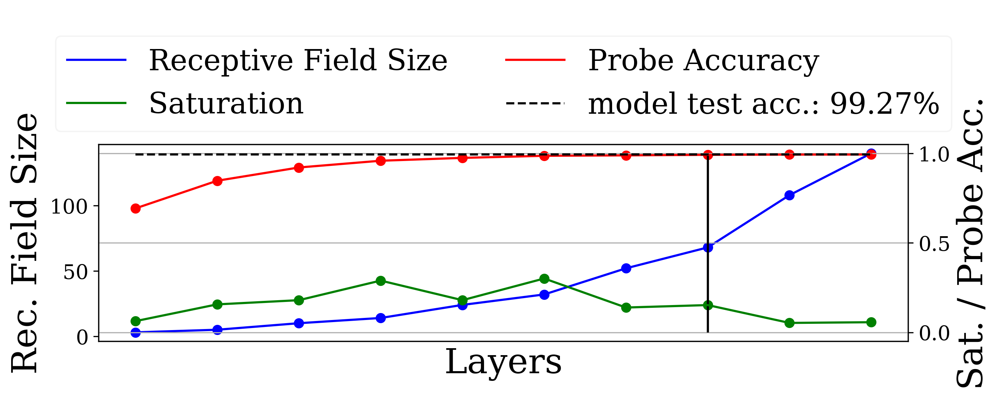

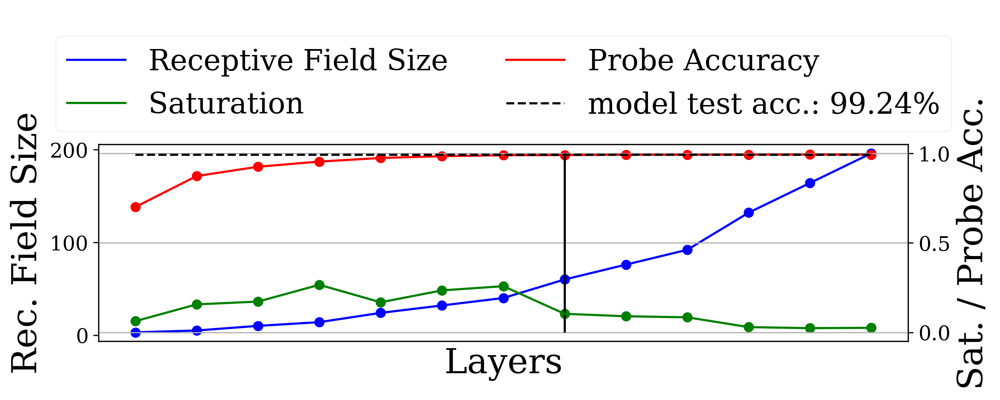

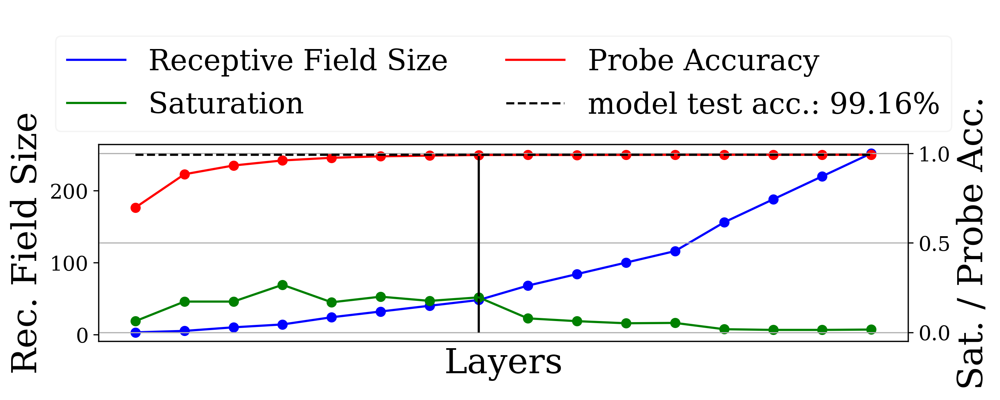

In [139]:
for model in ['VGG11', 'VGG13', 'VGG16', 'VGG19']:
    dataset = 'MNIST'
    input_res = 32
    batch_size = 64
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'RES'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    savepath = os.path.join(path,f'{model}_{dataset}_{input_res}.png')
    plt.savefig(savepath, bbox_inches='tight')

8 8 10
10 10 12
13 13 15
16 16 18


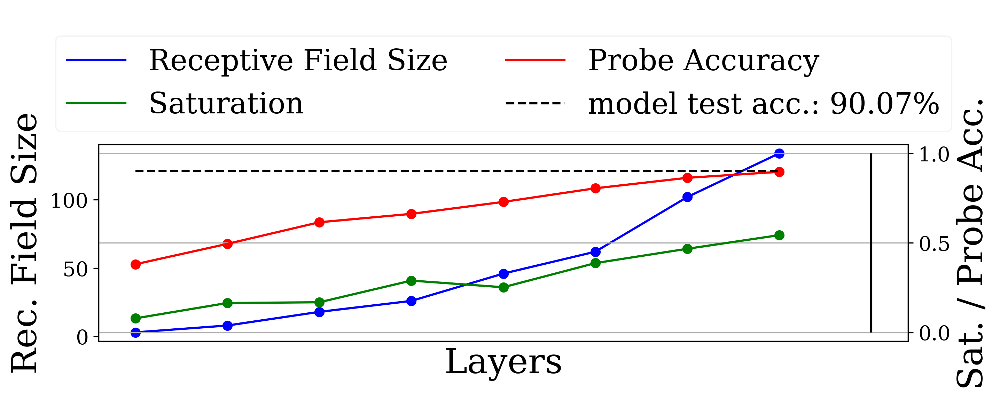

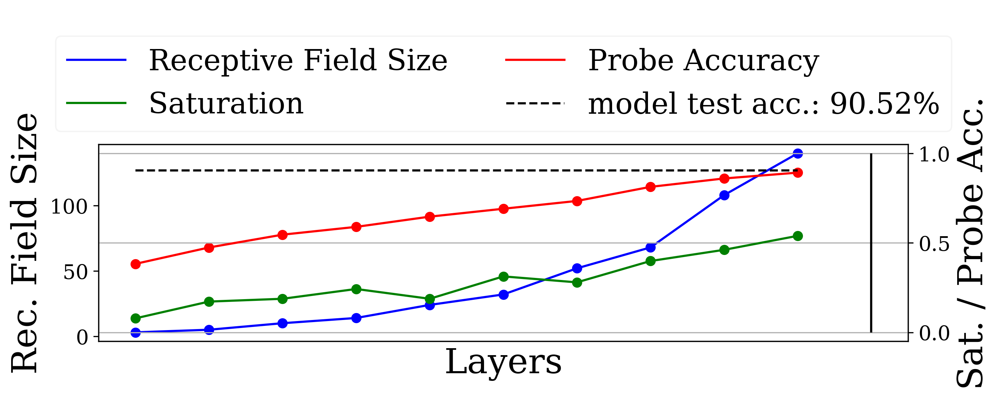

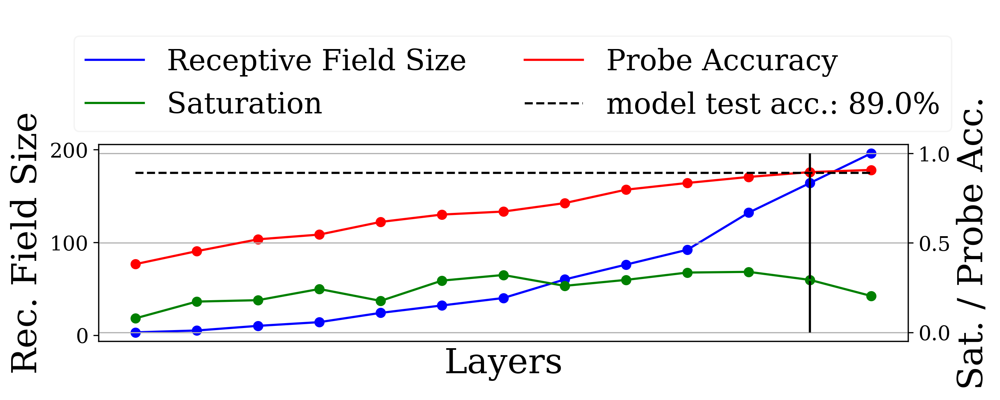

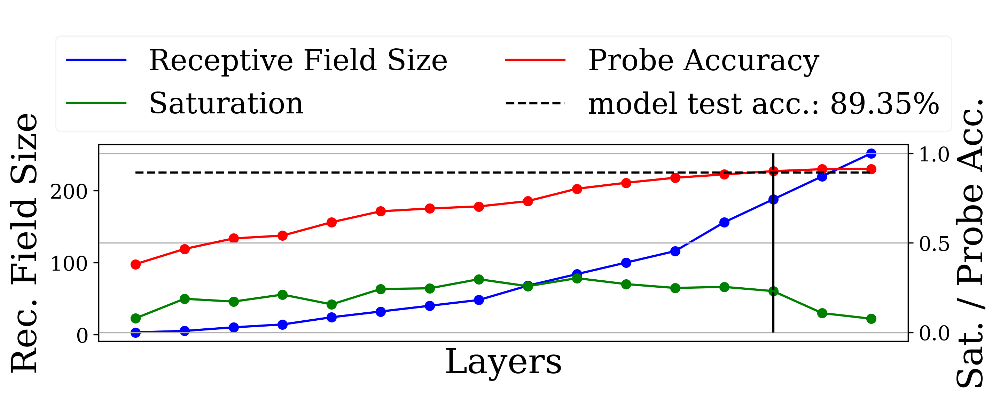

In [140]:
for model in ['VGG11', 'VGG13', 'VGG16', 'VGG19']:
    dataset = 'Cifar10'
    input_res = 128
    batch_size = 128
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'B2P'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    plt.savefig(f"./receptive_field_plots/{model}_{dataset}_{input_res}.png")

8 8 10
10 10 12
13 13 15
16 16 18


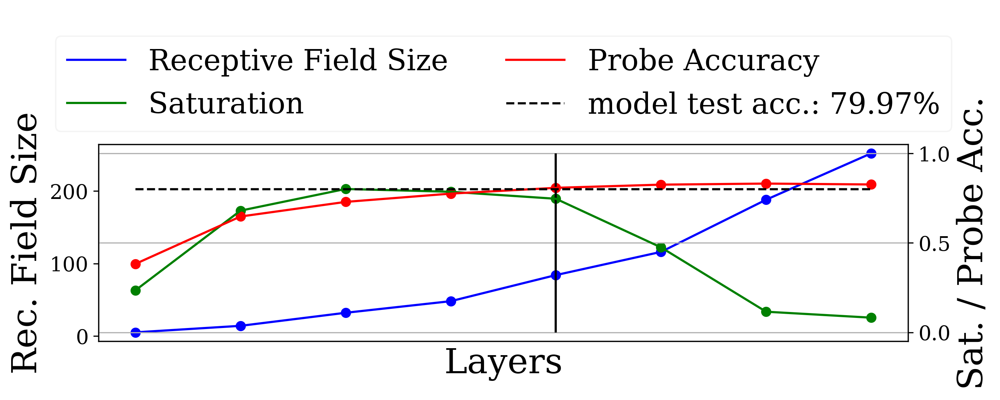

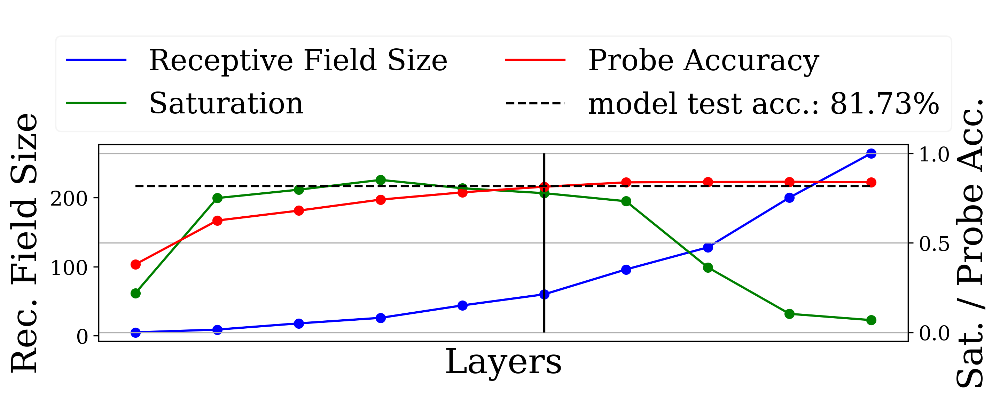

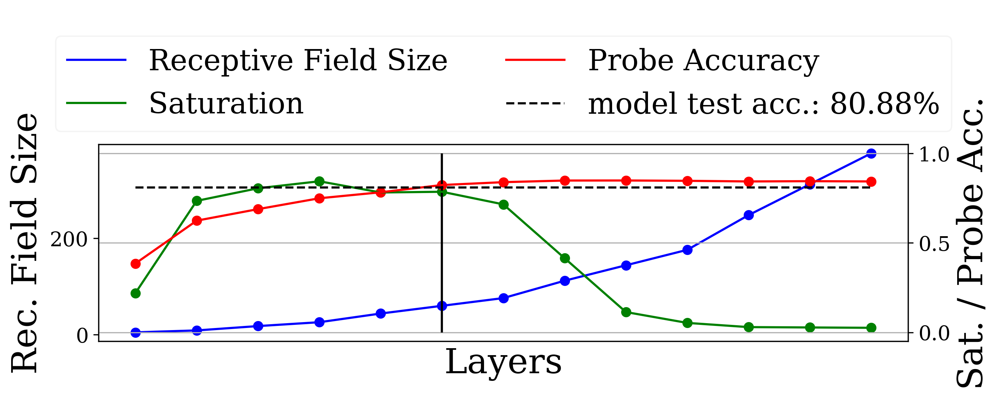

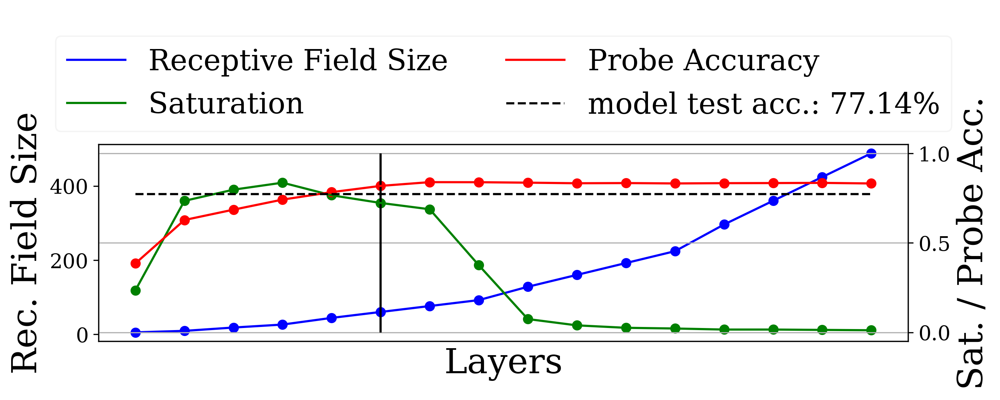

In [141]:
for model in ['VGG11_D2', 'VGG13_D2', 'VGG16_D2', 'VGG19_D2']:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 512
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'B2P'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    plt.savefig(f"./receptive_field_plots/{model}_{dataset}_{input_res}.png")

8 8 10
10 10 12
13 13 15
16 16 18


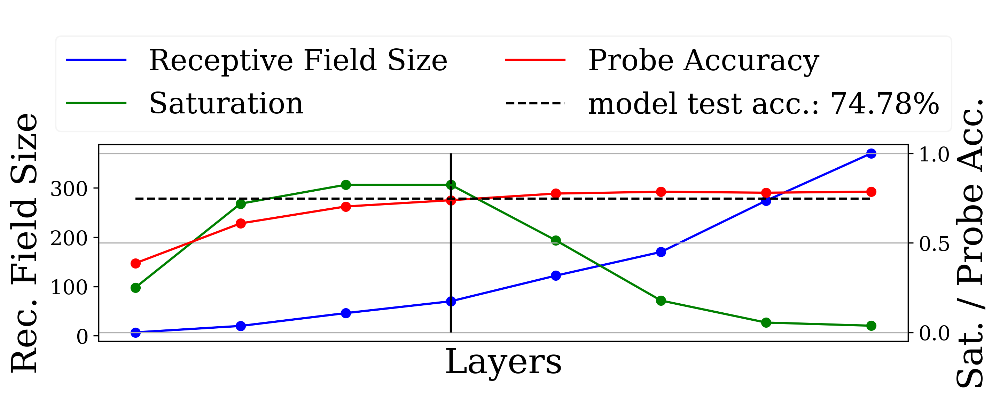

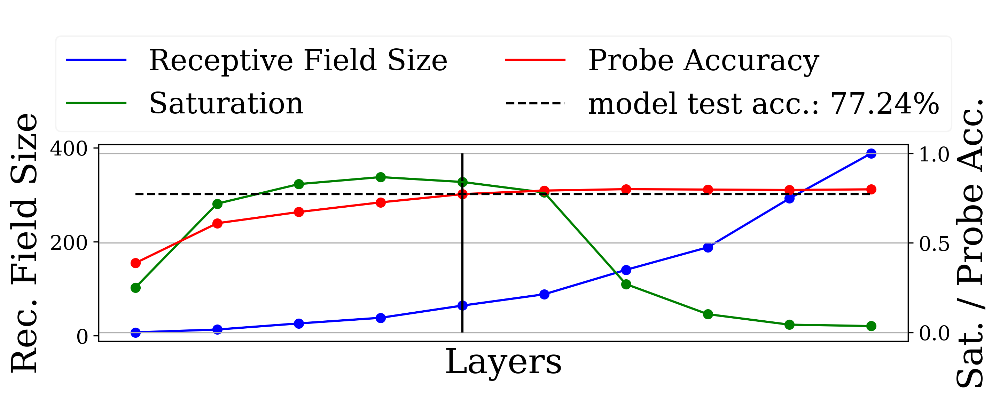

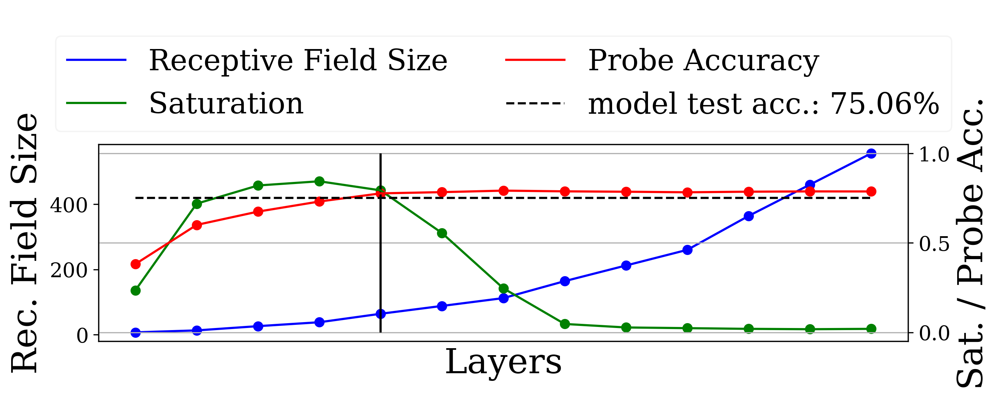

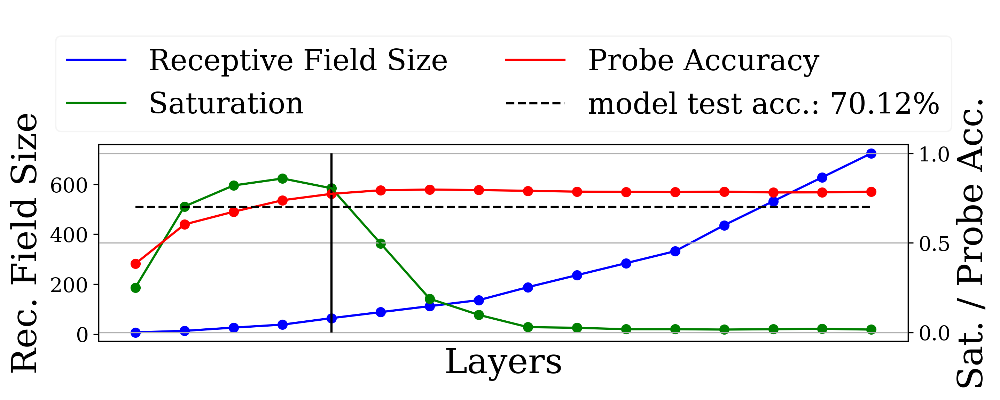

In [142]:
for model in ['VGG11_D3', 'VGG13_D3', 'VGG16_D3', 'VGG19_D3']:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 200
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'B2P'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    plt.savefig(f"./receptive_field_plots/{model}_{dataset}_{input_res}.png")

16 16 18
16 16 18
16 16 18


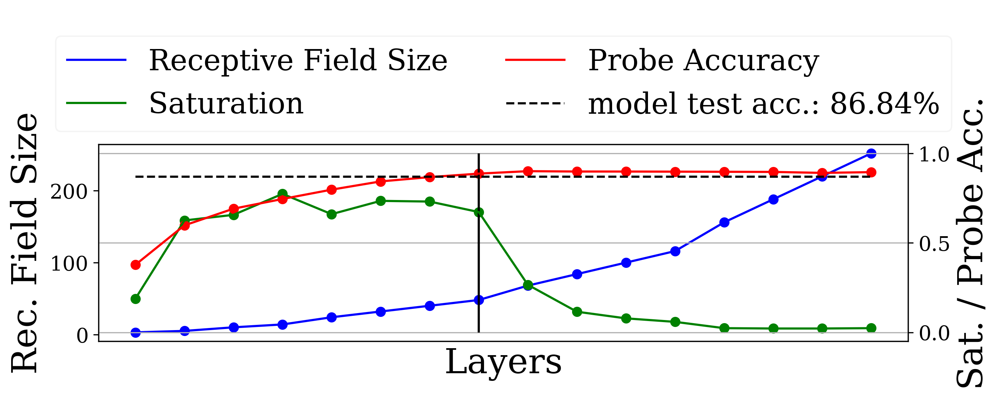

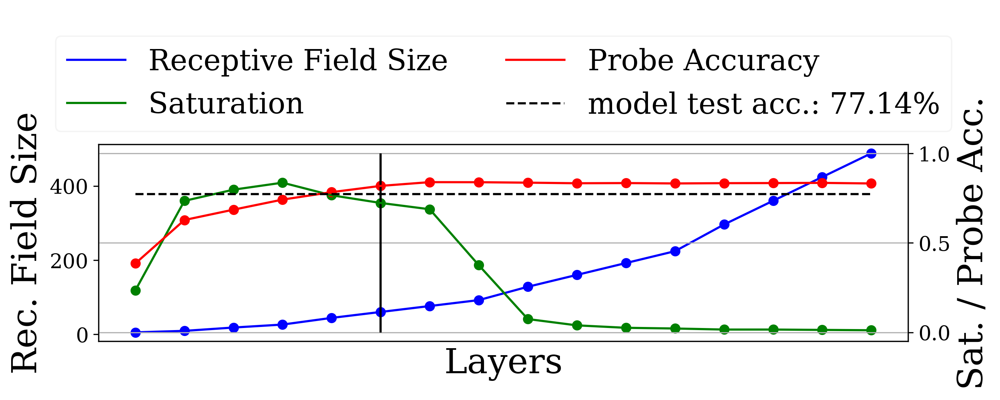

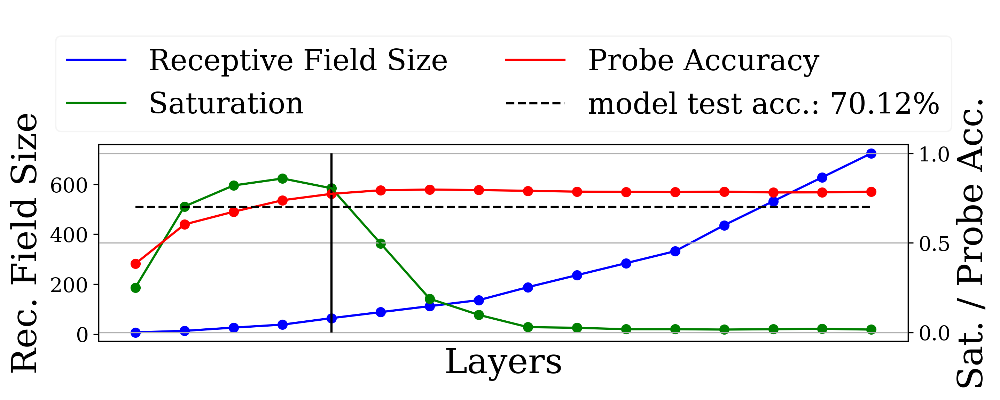

In [143]:
for model in ['VGG19', 'VGG19_D2', 'VGG19_D3']:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 200 if "D3" in model else 512
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'B2P'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    plt.savefig(f"./receptive_field_plots/{model}_{dataset}_{input_res}.png")

13 13 15
13 13 15
13 13 15


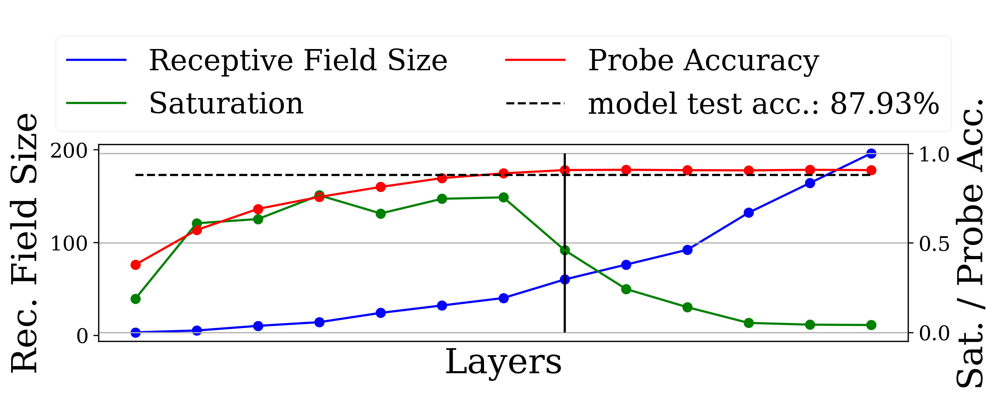

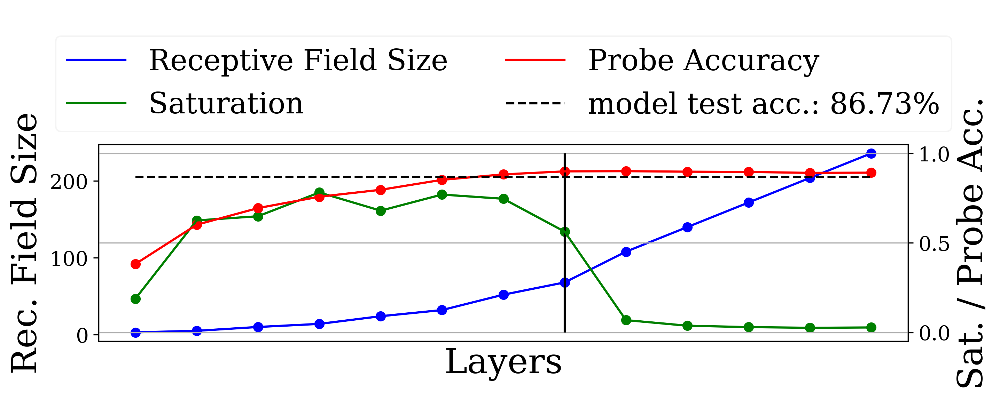

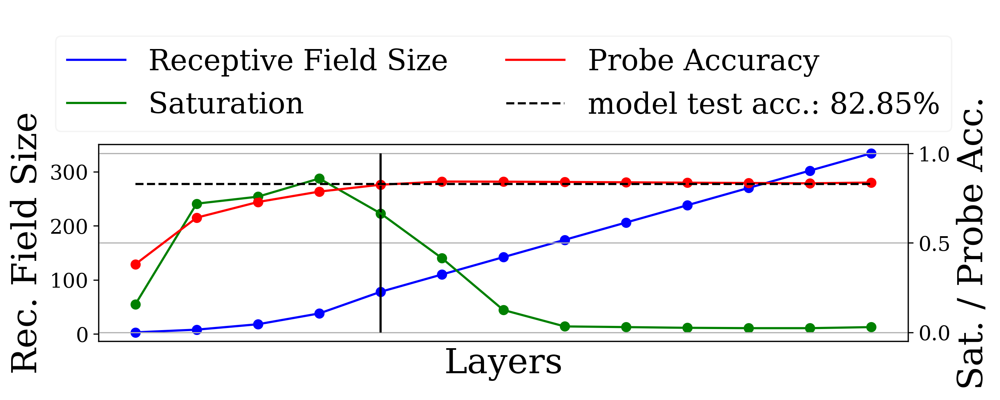

In [144]:
for model in ["VGG16", 'VGG16_P', "VGG16_P2"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 200 if "D3" in model else 512
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'B2P'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    plt.savefig(f"./receptive_field_plots/{model}_{dataset}_{input_res}.png")

13 13 15
13 13 15
13 13 15


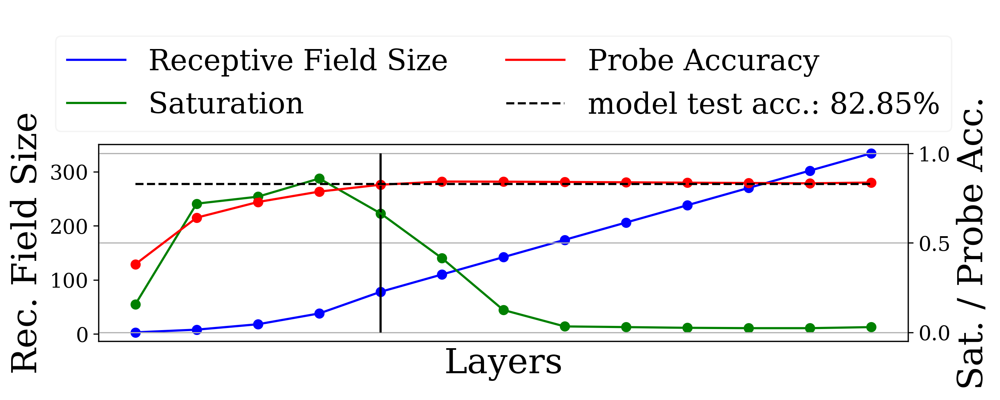

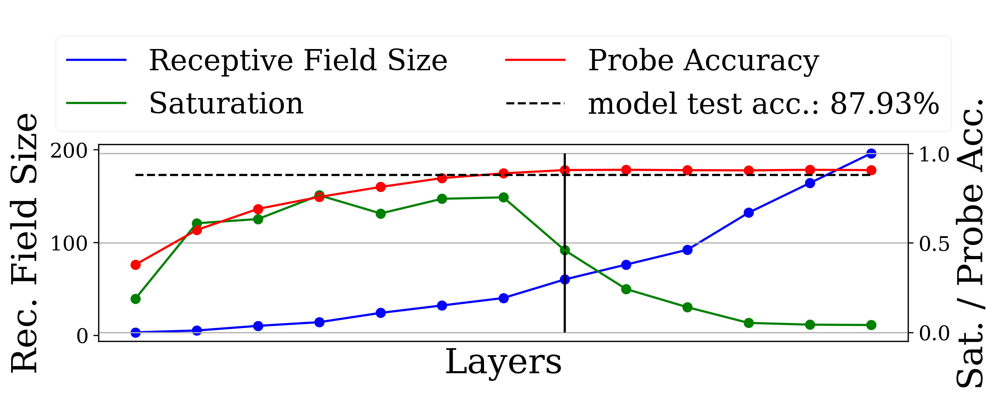

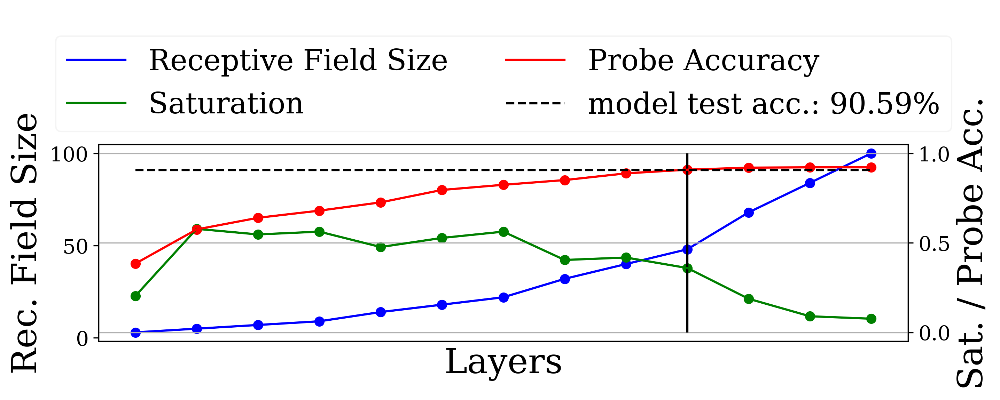

In [145]:
for model in ['VGG16_P2', "VGG16", "VGG16_AP7"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 256 if "AP7" in model else 512
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'B2P'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    plt.savefig(f"./receptive_field_plots/{model}_{dataset}_{input_res}.png")

13 13 15
13 13 15


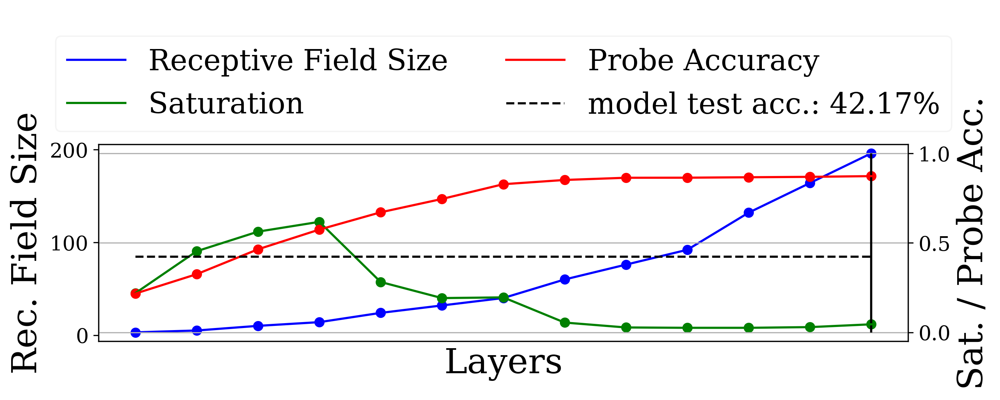

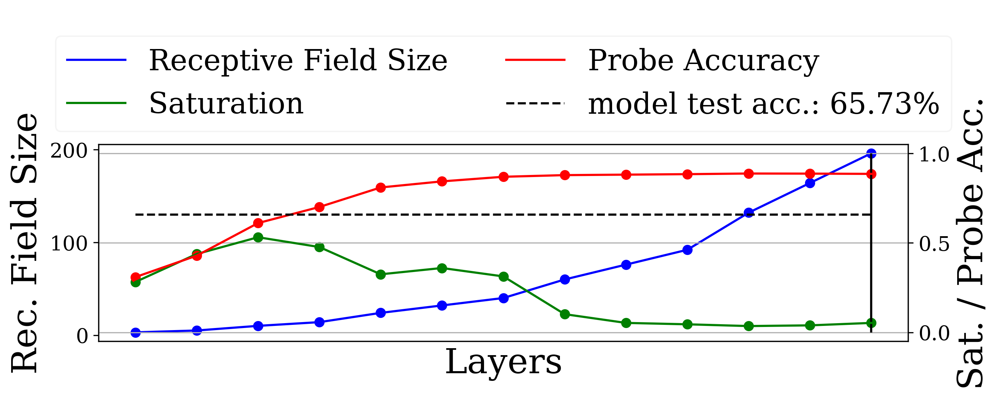

In [146]:
for dataset in ["Cifar10SmallRandomPositioning", "BlackBorderCifar10"]:
    model = 'VGG16'
    input_res = 160
    batch_size = 64
    epochs = 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'B2P'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    plt.savefig(f"./receptive_field_plots/{model}_{dataset}_{input_res}.png")

17 17 21
25 25 30
33 33 37
49 49 54


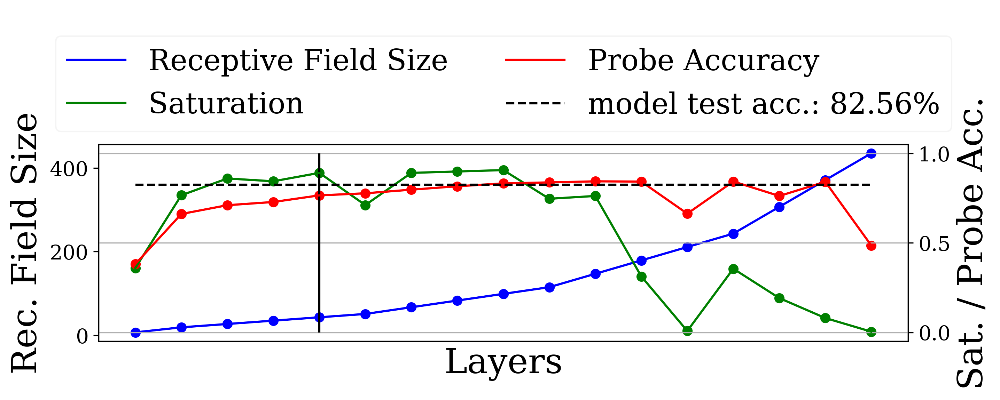

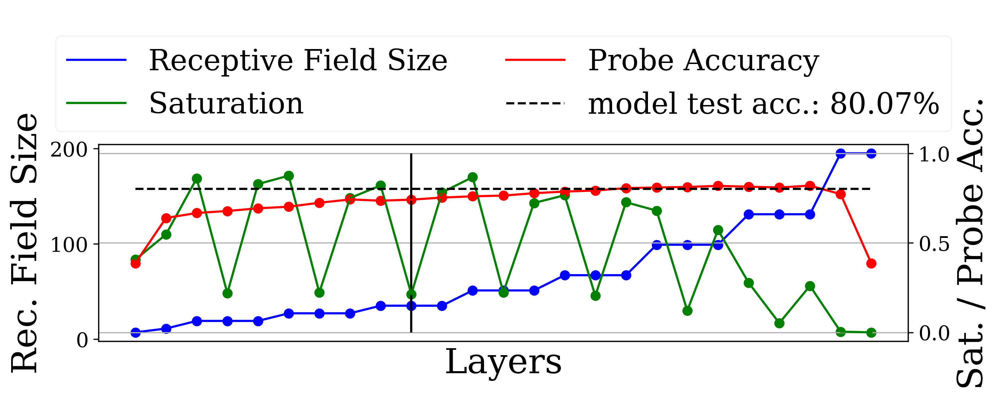

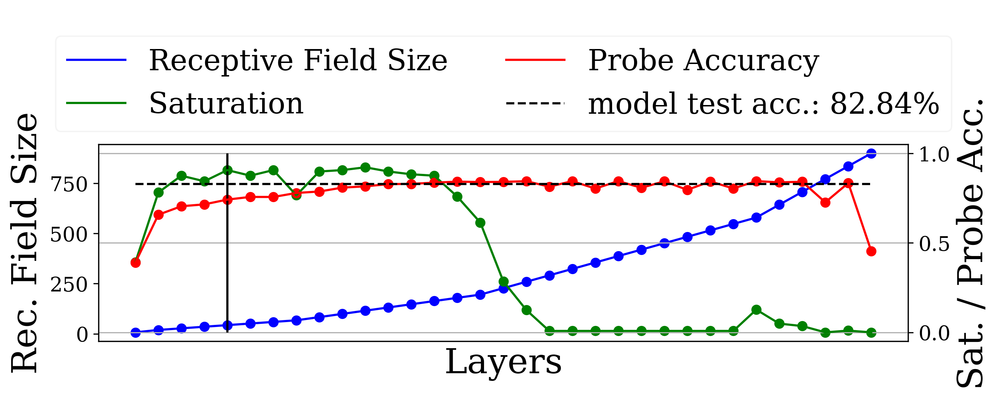

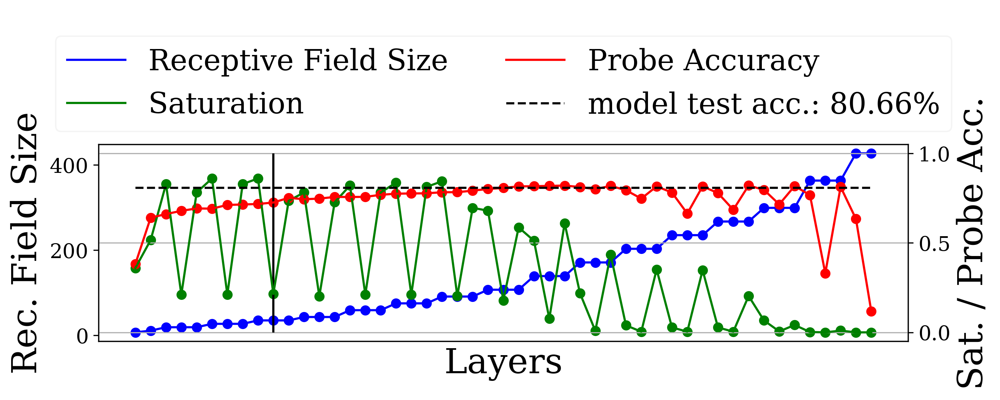

In [147]:
for model in ['ResNet18', "ResNet18_Bottleneck", "ResNet34", "ResNet50"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 512
    epochs = 50 if not "Bottleneck" in model else 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'B2P'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    plt.savefig(f"./receptive_field_plots/{model}_{dataset}_{input_res}.png")

49 49 54
49 49 50


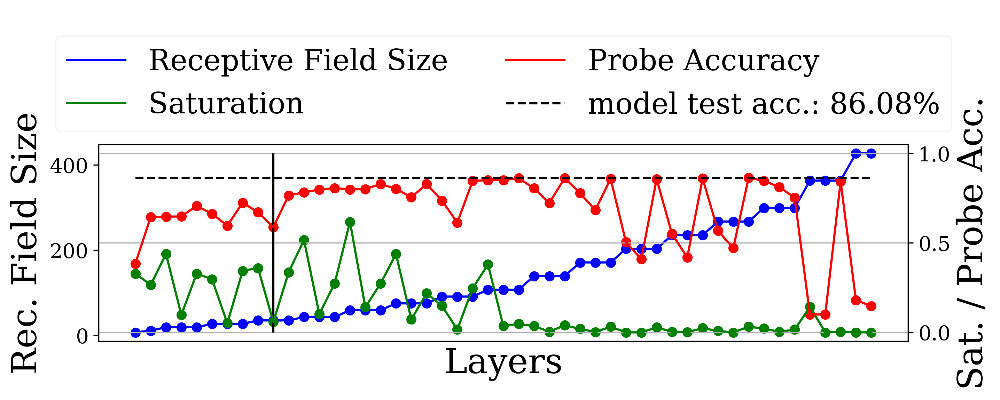

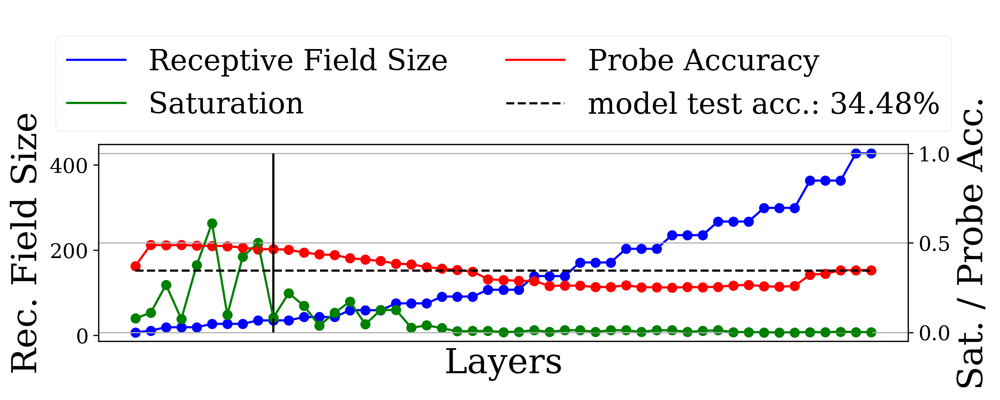

In [148]:
for model in ["ResNet50", "ResNet50NoSkip"]:
    dataset = 'Cifar10'
    input_res = 32
    batch_size = 64 if not "NoSkip" in model else 128
    epochs = 60 if not "NoSkip" in model else 30
    downsampling = 'None'
    thresh = 10000
    run_id = 'RES'

    plot_receptive_field(model, dataset, batch_size, epochs, downsampling, thresh, run_id, input_res)
    plt.savefig(f"./receptive_field_plots/{model}_{dataset}_{input_res}.png")